In [20]:
import torch
import torchvision
import torchvision.transforms as transforms
import numpy as np
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import json
import os
import matplotlib.pyplot as plt
from PIL import Image



### 1. Basics

In [ ]:
# Set device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")  # Updated for MPS support


In [ ]:
# Load pre-trained ResNet-34 model
pretrained_model = torchvision.models.resnet34(weights='IMAGENET1K_V1').to(device)
pretrained_model.eval()

In [16]:
# Define preprocessing transforms (add resize for ResNet-34)
mean_norms = np.array([0.485, 0.456, 0.406])
std_norms = np.array([0.229, 0.224, 0.225])
plain_transforms = transforms.Compose([
    transforms.Resize((224, 224)),  # Ensure image size matches ResNet-34 input
    transforms.ToTensor(),
    transforms.Normalize(mean=mean_norms, std=std_norms)
])

# Load test dataset
dataset_path = "./TestDataSet"  # Update with actual path
dataset = ImageFolder(root=dataset_path, transform=plain_transforms)
dataloader = DataLoader(dataset, batch_size=32, shuffle=False, num_workers=4)

# Load label mappings from JSON file
with open("./TestDataSet/labels_list.json", "r") as f:  # Update with actual JSON path
    label_mappings = json.load(f)

# Create a mapping from ImageFolder indices to ImageNet indices
# ImageFolder assigns indices based on folder names (alphabetical order)
folder_to_idx = {class_name: idx for idx, class_name in enumerate(dataset.classes)}

# Parse the JSON entries and sort by ImageNet index
label_mappings_parsed = []
for entry in label_mappings:
    imagenet_idx, class_name = entry.split(": ")
    label_mappings_parsed.append((int(imagenet_idx), class_name))
label_mappings_parsed.sort(key=lambda x: x[0])  # Sort by ImageNet index

# Sort folder names (WNIDs) to match ImageFolder's ordering
sorted_folders = sorted(dataset.classes)

# Map ImageFolder indices to ImageNet indices
# Assume the sorted WNIDs correspond to the sorted ImageNet indices
idx_to_imagenet_idx = {}
for folder_idx, (imagenet_idx, class_name) in enumerate(label_mappings_parsed):
    if folder_idx < len(sorted_folders):
        idx_to_imagenet_idx[folder_idx] = imagenet_idx
    else:
        print(f"Warning: More ImageNet indices than folders. Extra entry: {imagenet_idx}: {class_name}")

# Debugging: Print the mapping
print("Mapping (ImageFolder idx -> ImageNet idx):", idx_to_imagenet_idx)

# Check for unmapped ImageFolder indices
all_folder_indices = set(range(len(dataset.classes)))
mapped_indices = set(idx_to_imagenet_idx.keys())
unmapped_indices = all_folder_indices - mapped_indices
if unmapped_indices:
    print(f"Unmapped ImageFolder indices: {unmapped_indices}")
    for idx in unmapped_indices:
        print(f"Index {idx} corresponds to folder: {dataset.classes[idx]}")

# Function to compute top-k accuracy
def compute_topk_accuracy(outputs, labels, k=1):
    batch_size = labels.size(0)
    _, pred = outputs.topk(k, dim=1, largest=True, sorted=True)
    pred = pred.t()
    correct = pred.eq(labels.view(1, -1).expand_as(pred))
    correct_k = correct[:k].reshape(-1).float().sum(0, keepdim=True)
    return correct_k.mul_(100.0 / batch_size).item()

# Evaluate model
top1_correct = 0
top5_correct = 0
total = 0

with torch.no_grad():
    for images, labels in dataloader:
        images = images.to(device)
        # Map ImageFolder labels to ImageNet indices
        imagenet_labels = torch.tensor([idx_to_imagenet_idx[label.item()] for label in labels]).to(device)
        
        outputs = pretrained_model(images)
        
        # Compute top-1 and top-5 accuracy
        top1_correct += compute_topk_accuracy(outputs, imagenet_labels, k=1)
        top5_correct += compute_topk_accuracy(outputs, imagenet_labels, k=5)
        total += 1

# Calculate average accuracies
top1_accuracy = top1_correct / total
top5_accuracy = top5_correct / total

# Print results
print(f"Top-1 Accuracy: {top1_accuracy:.2f}%")
print(f"Top-5 Accuracy: {top5_accuracy:.2f}%")

Mapping (ImageFolder idx -> ImageNet idx): {0: 401, 1: 402, 2: 403, 3: 404, 4: 405, 5: 406, 6: 407, 7: 408, 8: 409, 9: 410, 10: 411, 11: 412, 12: 413, 13: 414, 14: 415, 15: 416, 16: 417, 17: 418, 18: 419, 19: 420, 20: 421, 21: 422, 22: 423, 23: 424, 24: 425, 25: 426, 26: 427, 27: 428, 28: 429, 29: 430, 30: 431, 31: 432, 32: 433, 33: 434, 34: 435, 35: 436, 36: 437, 37: 438, 38: 439, 39: 440, 40: 441, 41: 442, 42: 443, 43: 444, 44: 445, 45: 446, 46: 447, 47: 448, 48: 449, 49: 450, 50: 451, 51: 452, 52: 453, 53: 454, 54: 455, 55: 456, 56: 457, 57: 458, 58: 459, 59: 460, 60: 461, 61: 462, 62: 463, 63: 464, 64: 465, 65: 466, 66: 467, 67: 468, 68: 469, 69: 470, 70: 471, 71: 472, 72: 473, 73: 474, 74: 475, 75: 476, 76: 477, 77: 478, 78: 479, 79: 480, 80: 481, 81: 482, 82: 483, 83: 484, 84: 485, 85: 486, 86: 487, 87: 488, 88: 489, 89: 490, 90: 491, 91: 492, 92: 493, 93: 494, 94: 495, 95: 496, 96: 497, 97: 498, 98: 499, 99: 500}
Top-1 Accuracy: 75.39%
Top-5 Accuracy: 93.87%


### 2.

Starting FGSM attacks...
Processing image 0...
Processing image 50...
Processing image 100...
Processing image 150...
Processing image 200...
Processing image 250...
Processing image 300...
Processing image 350...
Processing image 400...
Processing image 450...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].


Original Top-1 Accuracy: 76.00%
Original Top-5 Accuracy: 94.20%
Adversarial Top-1 Accuracy: 6.20%
Adversarial Top-5 Accuracy: 35.40%
Accuracy drop (Top-1): 69.80%
Accuracy drop (Top-5): 58.80%


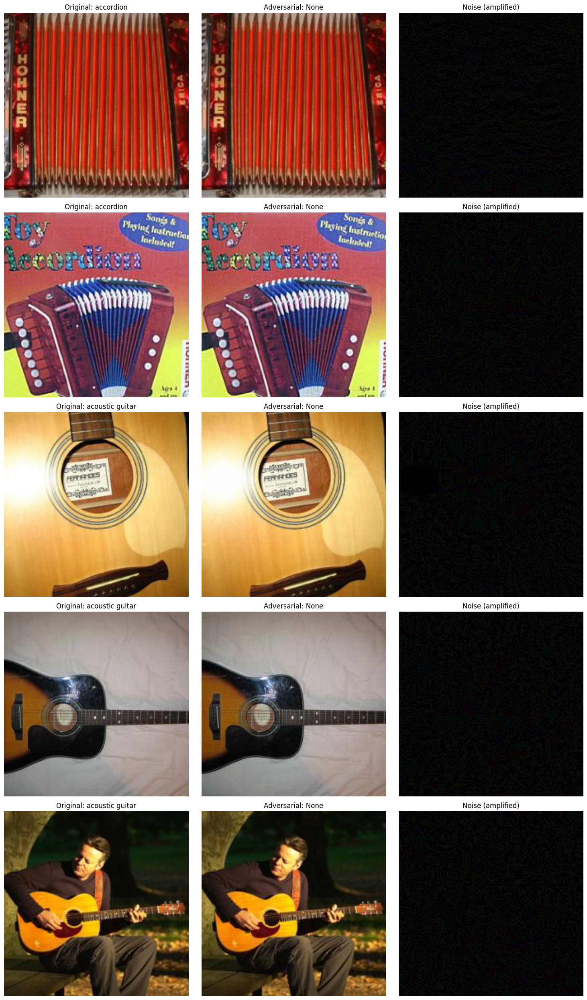

Verifying L∞ distances...
Maximum L∞ distance: 4.464285850524902
Average L∞ distance: 3.6419102997779844
L∞ constraint violated: 4.464285850524902 > 0.02


In [29]:
# Parameters for FGSM attack
epsilon = 0.02  # Attack budget

# Implement FGSM attack
def fgsm_attack(image, epsilon, data_grad):
    # Create the perturbed image by adjusting each pixel of the input image
    perturbed_image = image + epsilon * data_grad.sign()
    
    # Adding clipping to maintain the range of images
    # Normalization ranges from model:
    for i, (m, s) in enumerate(zip(mean_norms, std_norms)):
        perturbed_image[:, i] = torch.clamp(perturbed_image[:, i], (0-m)/s, (1-m)/s)
    
    return perturbed_image

# Create directory to save adversarial images
adv_dir = "./AdversarialTestSet1"
os.makedirs(adv_dir, exist_ok=True)

# Create a directory structure similar to the original dataset
for class_dir in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_dir)
    if os.path.isdir(class_path):
        os.makedirs(os.path.join(adv_dir, class_dir), exist_ok=True)

# Lists for visualization and tracking metrics
visualization_examples = []
num_examples = 0
original_correct_top1 = 0
original_correct_top5 = 0
adversarial_correct_top1 = 0
adversarial_correct_top5 = 0
total_images = 0

print("Starting FGSM attacks...")

for i, (image, label) in enumerate(dataloader):
    if i % 50 == 0:
        print(f"Processing image {i}...")
    
    image = image.to(device)
    label = label.to(device)
    
    # Map ImageFolder labels to ImageNet indices
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    # Evaluate original image
    with torch.no_grad():
        original_output = pretrained_model(image)
        orig_top1, orig_pred_idx = compute_topk_accuracy(original_output, imagenet_label, k=1)
        orig_top5, _ = compute_topk_accuracy(original_output, imagenet_label, k=5)
        
        original_correct_top1 += orig_top1 / 100.0  # Converting percentage to count
        original_correct_top5 += orig_top5 / 100.0
    
    # Get original prediction label
    orig_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{orig_pred_idx}:"):
            orig_pred_label = entry.split(": ")[1]
            break
    
    # Create adversarial example
    image.requires_grad = True
    
    # Forward pass
    output = pretrained_model(image)
    
    # Calculate loss
    loss = F.cross_entropy(output, imagenet_label)
    
    # Zero all existing gradients
    pretrained_model.zero_grad()
    
    # Calculate gradients of model in backward pass
    loss.backward()
    
    # Collect datagrad
    data_grad = image.grad.data
    
    # Call FGSM attack
    perturbed_image = fgsm_attack(image, epsilon, data_grad)
    
    # Re-classify the perturbed image
    with torch.no_grad():
        adv_output = pretrained_model(perturbed_image)
        adv_top1, adv_pred_idx = compute_topk_accuracy(adv_output, imagenet_label, k=1)
        adv_top5, _ = compute_topk_accuracy(adv_output, imagenet_label, k=5)
        
        adversarial_correct_top1 += adv_top1 / 100.0
        adversarial_correct_top5 += adv_top5 / 100.0
    
    # Get adversarial prediction label
    adv_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{adv_pred_idx}:"):
            adv_pred_label = entry.split(": ")[1]
            break
    
    # Save successful attack examples for visualization (only 3-5 examples)
    if orig_pred_idx != adv_pred_idx and num_examples < 5:
        orig_img = denormalize(image.squeeze(0))
        adv_img = denormalize(perturbed_image.squeeze(0))
        noise = (adv_img - orig_img) * 10  # Amplify the noise for better visualization
        
        visualization_examples.append({
            'original': orig_img,
            'adversarial': adv_img,
            'noise': noise,
            'orig_label': orig_pred_label,
            'adv_label': adv_pred_label
        })
        num_examples += 1
    
    # Save the adversarial image
    class_dir = dataset.classes[label.item()]
    img_filename = os.path.basename(dataset.imgs[i][0])
    adv_img_path = os.path.join(adv_dir, class_dir, img_filename)
    
    # Convert to PIL and save
    adv_img = denormalize(perturbed_image.squeeze(0))
    adv_img_pil = transforms.ToPILImage()(adv_img)
    adv_img_pil.save(adv_img_path)
    
    total_images += 1

# Calculate accuracy
original_top1_accuracy = 100 * original_correct_top1 / total_images
original_top5_accuracy = 100 * original_correct_top5 / total_images
adversarial_top1_accuracy = 100 * adversarial_correct_top1 / total_images
adversarial_top5_accuracy = 100 * adversarial_correct_top5 / total_images

print(f"Original Top-1 Accuracy: {original_top1_accuracy:.2f}%")
print(f"Original Top-5 Accuracy: {original_top5_accuracy:.2f}%")
print(f"Adversarial Top-1 Accuracy: {adversarial_top1_accuracy:.2f}%")
print(f"Adversarial Top-5 Accuracy: {adversarial_top5_accuracy:.2f}%")
print(f"Accuracy drop (Top-1): {original_top1_accuracy - adversarial_top1_accuracy:.2f}%")
print(f"Accuracy drop (Top-5): {original_top5_accuracy - adversarial_top5_accuracy:.2f}%")

# Visualize examples
if visualization_examples:
    fig, axes = plt.subplots(len(visualization_examples), 3, figsize=(15, 5*len(visualization_examples)))
    
    for i, example in enumerate(visualization_examples):
        # Handle case with only one example
        if len(visualization_examples) == 1:
            ax_row = axes
        else:
            ax_row = axes[i]
            
        # Original image
        ax_row[0].imshow(example['original'].permute(1, 2, 0))
        ax_row[0].set_title(f"Original: {example['orig_label']}")
        ax_row[0].axis('off')
        
        # Adversarial image
        ax_row[1].imshow(example['adversarial'].permute(1, 2, 0))
        ax_row[1].set_title(f"Adversarial: {example['adv_label']}")
        ax_row[1].axis('off')
        
        # Noise (amplified)
        ax_row[2].imshow(example['noise'].permute(1, 2, 0))
        ax_row[2].set_title("Noise (amplified)")
        ax_row[2].axis('off')
    
    plt.tight_layout()
    plt.savefig("adversarial_examples.png")
    plt.show()

# Verify L∞ distance between original and adversarial images
print("Verifying L∞ distances...")
adv_dataset = ImageFolder(root=adv_dir, transform=plain_transforms)
adv_dataloader = DataLoader(adv_dataset, batch_size=1, shuffle=False)

max_linf_dist = 0
sum_linf_dist = 0

for (orig_img, _), (adv_img, _) in zip(dataloader, adv_dataloader):
    # Move to CPU for comparison
    orig_img = orig_img.cpu()
    adv_img = adv_img.cpu()
    
    # Calculate L∞ distance
    linf_dist = torch.max(torch.abs(orig_img - adv_img)).item()
    max_linf_dist = max(max_linf_dist, linf_dist)
    sum_linf_dist += linf_dist

avg_linf_dist = sum_linf_dist / total_images
print(f"Maximum L∞ distance: {max_linf_dist}")
print(f"Average L∞ distance: {avg_linf_dist}")

if max_linf_dist <= epsilon:
    print(f"L∞ constraint satisfied: {max_linf_dist} <= {epsilon}")
else:
    print(f"L∞ constraint violated: {max_linf_dist} > {epsilon}")

### 3.


Starting improved attacks (PGD with momentum)...
Processing image 0...
Processing image 50...
Processing image 100...
Processing image 150...
Processing image 200...
Processing image 250...
Processing image 300...
Processing image 350...
Processing image 400...
Processing image 450...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].


Original Top-1 Accuracy: 76.00%
Original Top-5 Accuracy: 94.20%
Adversarial Top-1 Accuracy: 0.00%
Adversarial Top-5 Accuracy: 6.80%
Accuracy drop (Top-1): 76.00%
Accuracy drop (Top-5): 87.40%


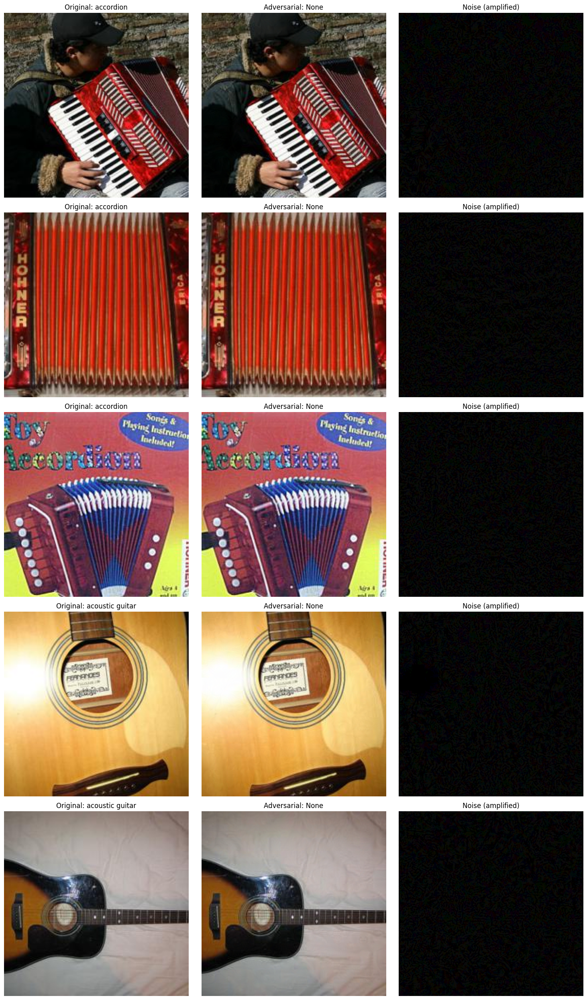

Verifying L∞ distances...
Maximum L∞ distance: 1.1131089925765991
Average L∞ distance: 0.22364826074242591
L∞ constraint violated: 1.1131089925765991 > 0.02


In [31]:
# Task 3: Improved attacks - PGD with momentum and increased iterations

# Create directory for Adversarial Test Set 2
adv_dir2 = "./AdversarialTestSet2"
os.makedirs(adv_dir2, exist_ok=True)

# Create a directory structure similar to the original dataset
for class_dir in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_dir)
    if os.path.isdir(class_path):
        os.makedirs(os.path.join(adv_dir2, class_dir), exist_ok=True)

# Parameters for improved attack
epsilon = 0.02     # Same constraint as before
alpha = 0.002      # Smaller step size for more iterations
iterations = 40    # Significantly more iterations
momentum = 0.9     # Add momentum for more effective attacks

# Implement PGD attack with momentum
def pgd_attack_with_momentum(image, epsilon, true_label, alpha, iterations, momentum):
    # Clone the original image
    perturbed_image = image.clone().detach()
    
    # Initialize momentum accumulator
    grad_momentum = torch.zeros_like(perturbed_image).to(device)
    
    for i in range(iterations):
        # Make sure we're computing gradients
        perturbed_image.requires_grad = True
        
        # Forward pass
        output = pretrained_model(perturbed_image)
        
        # Calculate loss (untargeted attack - maximize loss for true class)
        loss = F.cross_entropy(output, true_label)
        
        # Zero gradients
        pretrained_model.zero_grad()
        
        # Calculate gradients
        loss.backward()
        
        # Update momentum term
        grad = perturbed_image.grad.data
        grad_momentum = momentum * grad_momentum + grad / torch.norm(grad, p=1)
        
        # Create adversarial example using momentum
        with torch.no_grad():
            perturbed_image = perturbed_image + alpha * grad_momentum.sign()
            
            # Project back to epsilon ball centered on original image
            delta = perturbed_image - image
            delta = torch.clamp(delta, -epsilon, epsilon)
            perturbed_image = image + delta
            
            # Clip to valid image range (in normalized space)
            for j, (m, s) in enumerate(zip(mean_norms, std_norms)):
                perturbed_image[:, j] = torch.clamp(perturbed_image[:, j], (0-m)/s, (1-m)/s)
        
        # Detach the perturbed image for the next iteration
        perturbed_image = perturbed_image.detach()
    
    return perturbed_image

# Lists for tracking metrics
visualization_examples = []
num_examples = 0
original_correct_top1 = 0
original_correct_top5 = 0
adversarial_correct_top1 = 0
adversarial_correct_top5 = 0
total_images = 0

print("Starting improved attacks (PGD with momentum)...")

for i, (image, label) in enumerate(dataloader):
    if i % 50 == 0:
        print(f"Processing image {i}...")
    
    image = image.to(device)
    label = label.to(device)
    
    # Map ImageFolder labels to ImageNet indices
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    # Evaluate original image
    with torch.no_grad():
        original_output = pretrained_model(image)
        orig_top1, orig_pred_idx = compute_topk_accuracy(original_output, imagenet_label, k=1)
        orig_top5, _ = compute_topk_accuracy(original_output, imagenet_label, k=5)
        
        original_correct_top1 += orig_top1 / 100.0
        original_correct_top5 += orig_top5 / 100.0
    
    # Get original prediction label
    orig_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{orig_pred_idx}:"):
            orig_pred_label = entry.split(": ")[1]
            break
    
    # Apply PGD attack with momentum
    perturbed_image = pgd_attack_with_momentum(image, epsilon, imagenet_label, alpha, iterations, momentum)
    
    # Re-classify the perturbed image
    with torch.no_grad():
        adv_output = pretrained_model(perturbed_image)
        adv_top1, adv_pred_idx = compute_topk_accuracy(adv_output, imagenet_label, k=1)
        adv_top5, _ = compute_topk_accuracy(adv_output, imagenet_label, k=5)
        
        adversarial_correct_top1 += adv_top1 / 100.0
        adversarial_correct_top5 += adv_top5 / 100.0
    
    # Get adversarial prediction label
    adv_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{adv_pred_idx}:"):
            adv_pred_label = entry.split(": ")[1]
            break
    
    # Save successful attack examples for visualization (only 3-5 examples)
    if orig_pred_idx != adv_pred_idx and num_examples < 5:
        orig_img = denormalize(image.squeeze(0))
        adv_img = denormalize(perturbed_image.squeeze(0))
        noise = (adv_img - orig_img) * 10  # Amplify the noise for better visualization
        
        visualization_examples.append({
            'original': orig_img,
            'adversarial': adv_img,
            'noise': noise,
            'orig_label': orig_pred_label,
            'adv_label': adv_pred_label
        })
        num_examples += 1
    
    # Save the adversarial image
    class_dir = dataset.classes[label.item()]
    img_filename = os.path.basename(dataset.imgs[i][0])
    adv_img_path = os.path.join(adv_dir2, class_dir, img_filename)
    
    # Convert to PIL and save
    adv_img = denormalize(perturbed_image.squeeze(0))
    adv_img_pil = transforms.ToPILImage()(adv_img)
    adv_img_pil.save(adv_img_path)
    
    total_images += 1

# Calculate accuracy
original_top1_accuracy = 100 * original_correct_top1 / total_images
original_top5_accuracy = 100 * original_correct_top5 / total_images
adversarial_top1_accuracy = 100 * adversarial_correct_top1 / total_images
adversarial_top5_accuracy = 100 * adversarial_correct_top5 / total_images

print(f"Original Top-1 Accuracy: {original_top1_accuracy:.2f}%")
print(f"Original Top-5 Accuracy: {original_top5_accuracy:.2f}%")
print(f"Adversarial Top-1 Accuracy: {adversarial_top1_accuracy:.2f}%")
print(f"Adversarial Top-5 Accuracy: {adversarial_top5_accuracy:.2f}%")
print(f"Accuracy drop (Top-1): {original_top1_accuracy - adversarial_top1_accuracy:.2f}%")
print(f"Accuracy drop (Top-5): {original_top5_accuracy - adversarial_top5_accuracy:.2f}%")

# Visualize examples
if visualization_examples:
    fig, axes = plt.subplots(len(visualization_examples), 3, figsize=(15, 5*len(visualization_examples)))
    
    for i, example in enumerate(visualization_examples):
        # Handle case with only one example
        if len(visualization_examples) == 1:
            ax_row = axes
        else:
            ax_row = axes[i]
            
        # Original image
        ax_row[0].imshow(example['original'].permute(1, 2, 0))
        ax_row[0].set_title(f"Original: {example['orig_label']}")
        ax_row[0].axis('off')
        
        # Adversarial image
        ax_row[1].imshow(example['adversarial'].permute(1, 2, 0))
        ax_row[1].set_title(f"Adversarial: {example['adv_label']}")
        ax_row[1].axis('off')
        
        # Noise (amplified)
        ax_row[2].imshow(example['noise'].permute(1, 2, 0))
        ax_row[2].set_title("Noise (amplified)")
        ax_row[2].axis('off')
    
    plt.tight_layout()
    plt.savefig("improved_adversarial_examples.png")
    plt.show()

# Verify L∞ distance between original and adversarial images
print("Verifying L∞ distances...")
adv_dataset2 = ImageFolder(root=adv_dir2, transform=plain_transforms)
adv_dataloader2 = DataLoader(adv_dataset2, batch_size=1, shuffle=False)

max_linf_dist = 0
sum_linf_dist = 0

for (orig_img, _), (adv_img, _) in zip(dataloader, adv_dataloader2):
    # Move to CPU for comparison
    orig_img = orig_img.cpu()
    adv_img = adv_img.cpu()
    
    # Calculate L∞ distance
    linf_dist = torch.max(torch.abs(orig_img - adv_img)).item()
    max_linf_dist = max(max_linf_dist, linf_dist)
    sum_linf_dist += linf_dist

avg_linf_dist = sum_linf_dist / total_images
print(f"Maximum L∞ distance: {max_linf_dist}")
print(f"Average L∞ distance: {avg_linf_dist}")

if max_linf_dist <= epsilon:
    print(f"L∞ constraint satisfied: {max_linf_dist} <= {epsilon}")
else:
    print(f"L∞ constraint violated: {max_linf_dist} > {epsilon}")

Starting improved attacks (PGD)...
Processing image 0...
Processing image 50...
Processing image 100...
Processing image 150...
Processing image 200...
Processing image 250...
Processing image 300...
Processing image 350...
Processing image 400...
Processing image 450...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04580021..0.04580021].


Original Top-1 Accuracy: 76.00%
Original Top-5 Accuracy: 94.20%
Adversarial Top-1 Accuracy: 0.00%
Adversarial Top-5 Accuracy: 7.20%
Accuracy drop (Top-1): 76.00%
Accuracy drop (Top-5): 87.00%


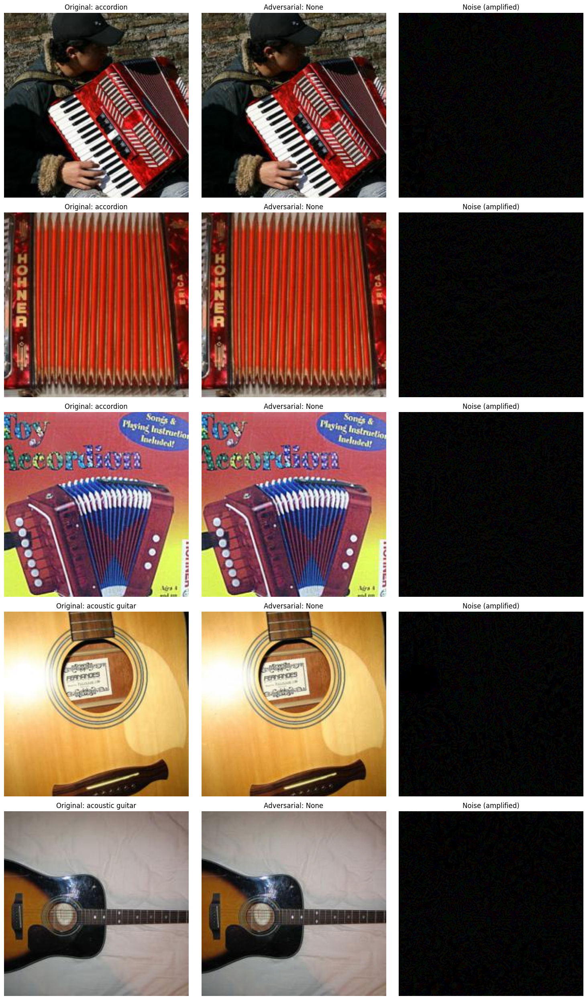

Verifying L∞ distances...
Maximum L∞ distance: 1.0959843397140503
Average L∞ distance: 0.2214225170314312
L∞ constraint violated: 1.0959843397140503 > 0.02
Task 3 completed!


In [34]:
# Task 3: Improved attacks - 修改版本

# Create directory for Adversarial Test Set 2
adv_dir2 = "./AdversarialTestSet2-ver2"
os.makedirs(adv_dir2, exist_ok=True)

# Create a directory structure similar to the original dataset
for class_dir in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_dir)
    if os.path.isdir(class_path):
        os.makedirs(os.path.join(adv_dir2, class_dir), exist_ok=True)

# Parameters for improved attack
epsilon = 0.02     # Same constraint as before
alpha = 0.002      # Smaller step size for more iterations
iterations = 40    # Significantly more iterations

# Implement PGD attack (Project Gradient Descent)
def pgd_attack(image, epsilon, true_label, alpha, iterations):
    # Clone the original image
    perturbed_image = image.clone().detach()
    
    for i in range(iterations):
        # Make sure we're computing gradients
        perturbed_image.requires_grad = True
        
        # Forward pass
        output = pretrained_model(perturbed_image)
        
        # Calculate loss (untargeted attack - maximize loss for true class)
        loss = F.cross_entropy(output, true_label)
        
        # Zero gradients
        pretrained_model.zero_grad()
        
        # Calculate gradients
        loss.backward()
        
        # Create adversarial example
        with torch.no_grad():
            perturbed_image = perturbed_image + alpha * perturbed_image.grad.sign()
            
            # Project back to epsilon ball centered on original image
            delta = perturbed_image - image
            delta = torch.clamp(delta, -epsilon, epsilon)
            perturbed_image = image + delta
            
            # Clip to valid image range (in normalized space)
            for j, (m, s) in enumerate(zip(mean_norms, std_norms)):
                perturbed_image[:, j] = torch.clamp(perturbed_image[:, j], (0-m)/s, (1-m)/s)
        
        # Detach the perturbed image for the next iteration
        perturbed_image = perturbed_image.detach()
    
    return perturbed_image

# Lists for tracking metrics
visualization_examples = []
num_examples = 0
original_correct_top1 = 0
original_correct_top5 = 0
adversarial_correct_top1 = 0
adversarial_correct_top5 = 0
total_images = 0

print("Starting improved attacks (PGD)...")

for i, (image, label) in enumerate(dataloader):
    if i % 50 == 0:
        print(f"Processing image {i}...")
    
    image = image.to(device)
    label = label.to(device)
    
    # Map ImageFolder labels to ImageNet indices
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    # Evaluate original image
    with torch.no_grad():
        original_output = pretrained_model(image)
        orig_top1, orig_pred_idx = compute_topk_accuracy(original_output, imagenet_label, k=1)
        orig_top5, _ = compute_topk_accuracy(original_output, imagenet_label, k=5)
        
        original_correct_top1 += orig_top1 / 100.0
        original_correct_top5 += orig_top5 / 100.0
    
    # Get original prediction label
    orig_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{orig_pred_idx}:"):
            orig_pred_label = entry.split(": ")[1]
            break
    
    # Apply PGD attack
    perturbed_image = pgd_attack(image, epsilon, imagenet_label, alpha, iterations)
    
    # Re-classify the perturbed image
    with torch.no_grad():
        adv_output = pretrained_model(perturbed_image)
        adv_top1, adv_pred_idx = compute_topk_accuracy(adv_output, imagenet_label, k=1)
        adv_top5, _ = compute_topk_accuracy(adv_output, imagenet_label, k=5)
        
        adversarial_correct_top1 += adv_top1 / 100.0
        adversarial_correct_top5 += adv_top5 / 100.0
    
    # Get adversarial prediction label
    adv_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{adv_pred_idx}:"):
            adv_pred_label = entry.split(": ")[1]
            break
    
    # Save successful attack examples for visualization (only 3-5 examples)
    if orig_pred_idx != adv_pred_idx and num_examples < 5:
        orig_img = denormalize(image.squeeze(0))
        adv_img = denormalize(perturbed_image.squeeze(0))
        
        # 计算并放大噪声，便于可视化
        noise = (adv_img - orig_img) * 10  # 放大噪声
        
        visualization_examples.append({
            'original': orig_img,
            'adversarial': adv_img,
            'noise': noise,
            'orig_label': orig_pred_label,
            'adv_label': adv_pred_label
        })
        num_examples += 1
    
    # Save the adversarial image
    class_dir = dataset.classes[label.item()]
    img_filename = os.path.basename(dataset.imgs[i][0])
    adv_img_path = os.path.join(adv_dir2, class_dir, img_filename)
    
    # Convert to PIL and save
    adv_img = denormalize(perturbed_image.squeeze(0))
    adv_img_pil = transforms.ToPILImage()(adv_img)
    adv_img_pil.save(adv_img_path)
    
    total_images += 1

# Calculate accuracy
original_top1_accuracy = 100 * original_correct_top1 / total_images
original_top5_accuracy = 100 * original_correct_top5 / total_images
adversarial_top1_accuracy = 100 * adversarial_correct_top1 / total_images
adversarial_top5_accuracy = 100 * adversarial_correct_top5 / total_images

print(f"Original Top-1 Accuracy: {original_top1_accuracy:.2f}%")
print(f"Original Top-5 Accuracy: {original_top5_accuracy:.2f}%")
print(f"Adversarial Top-1 Accuracy: {adversarial_top1_accuracy:.2f}%")
print(f"Adversarial Top-5 Accuracy: {adversarial_top5_accuracy:.2f}%")
print(f"Accuracy drop (Top-1): {original_top1_accuracy - adversarial_top1_accuracy:.2f}%")
print(f"Accuracy drop (Top-5): {original_top5_accuracy - adversarial_top5_accuracy:.2f}%")

# 改进可视化部分
if visualization_examples:
    fig, axes = plt.subplots(len(visualization_examples), 3, figsize=(15, 5*len(visualization_examples)))
    
    for i, example in enumerate(visualization_examples):
        # Handle case with only one example
        if len(visualization_examples) == 1:
            ax_row = axes
        else:
            ax_row = axes[i]
            
        # Original image
        ax_row[0].imshow(example['original'].permute(1, 2, 0))
        ax_row[0].set_title(f"Original: {example['orig_label']}")
        ax_row[0].axis('off')
        
        # Adversarial image
        ax_row[1].imshow(example['adversarial'].permute(1, 2, 0))
        ax_row[1].set_title(f"Adversarial: {example['adv_label']}")
        ax_row[1].axis('off')
        
        # Noise visualization
        ax_row[2].imshow(example['noise'].permute(1, 2, 0))
        ax_row[2].set_title("Noise (amplified)")
        ax_row[2].axis('off')
    
    plt.tight_layout()
    plt.savefig("improved_adversarial_examples.png")
    plt.show()

# 验证L∞约束
print("Verifying L∞ distances...")
adv_dataset2 = ImageFolder(root=adv_dir2, transform=plain_transforms)
adv_dataloader2 = DataLoader(adv_dataset2, batch_size=1, shuffle=False)

max_linf_dist = 0
sum_linf_dist = 0

for (orig_img, _), (adv_img, _) in zip(dataloader, adv_dataloader2):
    # Move to CPU for comparison
    orig_img = orig_img.cpu()
    adv_img = adv_img.cpu()
    
    # Calculate L∞ distance
    linf_dist = torch.max(torch.abs(orig_img - adv_img)).item()
    max_linf_dist = max(max_linf_dist, linf_dist)
    sum_linf_dist += linf_dist

avg_linf_dist = sum_linf_dist / total_images
print(f"Maximum L∞ distance: {max_linf_dist}")
print(f"Average L∞ distance: {avg_linf_dist}")

if max_linf_dist <= epsilon:
    print(f"L∞ constraint satisfied: {max_linf_dist} <= {epsilon}")
else:
    print(f"L∞ constraint violated: {max_linf_dist} > {epsilon}")

print("Task 3 completed!")

### 4.

Total dataset size: 500
Evaluating on subset of 250 images (50%)
Starting simple patch attacks...
Processing image 0/250...
Processing image 10/250...
Processing image 20/250...
Processing image 30/250...
Processing image 40/250...
Processing image 50/250...
Processing image 60/250...
Processing image 70/250...
Processing image 80/250...
Processing image 90/250...
Processing image 100/250...
Processing image 110/250...
Processing image 120/250...
Processing image 130/250...
Processing image 140/250...
Processing image 150/250...
Processing image 160/250...
Processing image 170/250...
Processing image 180/250...
Processing image 190/250...
Processing image 200/250...
Processing image 210/250...
Processing image 220/250...
Processing image 230/250...
Processing image 240/250...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.916..0.9160003].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9160003..0.9160003].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9160001..0.9160003].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9160001..0.9160003].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9160001..0.9160001].


[SUBSET EVALUATION] Original Top-1 Accuracy: 79.20%
[SUBSET EVALUATION] Original Top-5 Accuracy: 96.40%
[SUBSET EVALUATION] Adversarial Top-1 Accuracy: 52.80%
[SUBSET EVALUATION] Adversarial Top-5 Accuracy: 78.80%
[SUBSET EVALUATION] Accuracy drop (Top-1): 26.40%
[SUBSET EVALUATION] Accuracy drop (Top-5): 17.60%


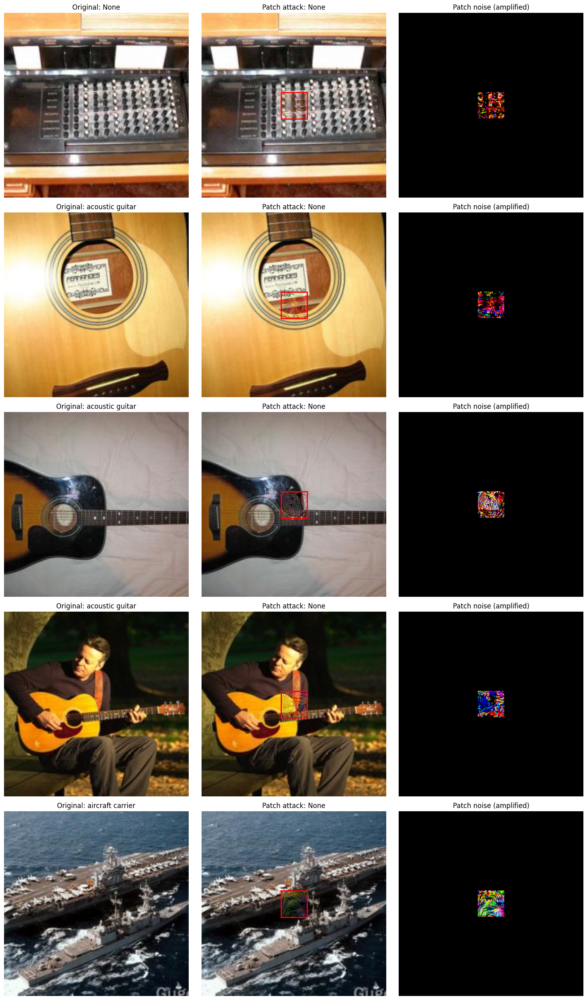

Subset evaluation completed!
NOTE: To run on the full dataset, change 'evaluation_percentage' to 1.0


In [37]:
# Task 4: Patch attacks (with subset evaluation)

# 添加这个参数控制使用多少比例的数据集
evaluation_percentage = 0.5  # 使用50%的数据集

# Create directory for Adversarial Test Set 3
adv_dir3 = "./AdversarialTestSet3"
os.makedirs(adv_dir3, exist_ok=True)

# Create directory structure
for class_dir in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_dir)
    if os.path.isdir(class_path):
        os.makedirs(os.path.join(adv_dir3, class_dir), exist_ok=True)

# 参数设置
patch_size = 32
epsilon = 0.5       # 使用更大的epsilon
alpha = 0.03        # 步长
iterations = 50     # 迭代次数

# 实现简单直接的补丁攻击
# def simple_patch_attack(image, label, patch_size, epsilon, alpha, iterations):
#     # 克隆原始图像
#     perturbed_image = image.clone().detach()
    
#     # 获取图像尺寸
#     _, _, height, width = image.shape
    
#     # 补丁位置 - 选择图像中心
#     top = (height - patch_size) // 2
#     left = (width - patch_size) // 2
    
#     # 创建补丁掩码
#     mask = torch.zeros_like(image).to(device)
#     mask[:, :, top:top+patch_size, left:left+patch_size] = 1.0
    
#     # 获取ImageNet标签
#     imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
#     # 选择目标类 (在1000个类中选择一个远离原始类的类)
#     target_class = (imagenet_label.item() + 500) % 1000
#     target = torch.tensor([target_class]).to(device)
    
#     # 直接初始化补丁区域为极端值
#     with torch.no_grad():
#         # 为补丁区域使用极端值初始化（对比度高的模式）
#         for c in range(3):  # 对每个颜色通道
#             if c % 3 == 0:
#                 perturbed_image[:, c, top:top+patch_size, left:left+patch_size] = 1.0
#             else:
#                 perturbed_image[:, c, top:top+patch_size, left:left+patch_size] = -1.0
    
#     # 优化补丁
#     for i in range(iterations):
#         # 设置requires_grad
#         perturbed_image.requires_grad = True
        
#         # 前向传播
#         output = pretrained_model(perturbed_image)
        
#         # 计算损失 (针对性攻击 - 最小化目标类的损失)
#         loss = F.cross_entropy(output, target)  # 降低目标类损失
        
#         # 梯度清零
#         pretrained_model.zero_grad()
        
#         # 计算梯度
#         loss.backward()
        
#         # 只更新补丁区域
#         with torch.no_grad():
#             # 使用带符号的梯度更新
#             grad = perturbed_image.grad.data * mask
#             perturbed_image = perturbed_image - alpha * torch.sign(grad)  # 减号是关键
            
#             # 限制扰动在epsilon范围内
#             delta = (perturbed_image - image) * mask
#             delta = torch.clamp(delta, -epsilon, epsilon)
#             perturbed_image = image + delta
            
#             # 确保值在有效范围内
#             for j, (m, s) in enumerate(zip(mean_norms, std_norms)):
#                 perturbed_image[:, j] = torch.clamp(perturbed_image[:, j], (0-m)/s, (1-m)/s)
        
#         # 分离以准备下一次迭代
#         perturbed_image = perturbed_image.detach()
    
#     return perturbed_image, (top, left, top+patch_size, left+patch_size)


# Task 4: Improved Targeted Patch Attack

# Parameters for advanced patch attack
patch_size = 32
epsilon = 0.8       # Using a larger epsilon as allowed by instructions
alpha = 0.07        # Larger step size for faster convergence
iterations = 80     # More iterations for better optimization
evaluation_percentage = 0.5  # Using 50% of the dataset

# Improved targeted patch attack implementation
def targeted_patch_attack(image, label, patch_size, epsilon, alpha, iterations):
    # Clone the original image
    perturbed_image = image.clone().detach()
    
    # Get image dimensions
    _, _, height, width = image.shape
    
    # Place patch in the center (most effective for most images)
    top = (height - patch_size) // 2
    left = (width - patch_size) // 2
    
    # Create patch mask (1 for patch area, 0 elsewhere)
    mask = torch.zeros_like(image).to(device)
    mask[:, :, top:top+patch_size, left:left+patch_size] = 1.0
    
    # Get true label
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    # Choose a target class that's conceptually far from the original
    # Target a class with index far from the original for conceptual distance
    target_class = (imagenet_label.item() + 500) % 1000
    target = torch.tensor([target_class]).to(device)
    
    # Initialize the patch with high-contrast patterns (more extreme values)
    with torch.no_grad():
        # Create a checkerboard pattern with higher contrast
        check_size = 4  # Size of each square in the checkerboard
        for i in range(0, patch_size, check_size):
            for j in range(0, patch_size, check_size):
                if (i // check_size + j // check_size) % 2 == 0:
                    # Initialize with extreme positive values for the channels
                    perturbed_image[:, :, top+i:min(top+i+check_size, top+patch_size), 
                                    left+j:min(left+j+check_size, left+patch_size)] = 2.0
                else:
                    # Initialize with extreme negative values for the channels
                    perturbed_image[:, :, top+i:min(top+i+check_size, top+patch_size), 
                                    left+j:min(left+j+check_size, left+patch_size)] = -2.0
    
    # Schedule for decreasing learning rate
    alphas = [alpha * (0.9 ** (i // 10)) for i in range(iterations)]
    
    # Track momentum for better optimization
    grad_momentum = torch.zeros_like(image).to(device)
    momentum_weight = 0.9
    
    # Optimization loop
    for i in range(iterations):
        # Set requires_grad for current iteration
        perturbed_image.requires_grad = True
        
        # Forward pass
        output = pretrained_model(perturbed_image)
        
        # Calculate both targeted loss (to push toward target class)
        # and untargeted loss (to push away from true class)
        targeted_loss = -F.cross_entropy(output, target)  # Negative for targeted
        untargeted_loss = F.cross_entropy(output, imagenet_label)  # Positive for untargeted
        
        # Combined loss with adaptive weighting based on iteration
        # Start with more weight on untargeted, gradually shift to targeted
        target_weight = min(0.9, 0.3 + i / iterations * 0.6)
        loss = target_weight * targeted_loss + (1 - target_weight) * untargeted_loss
        
        # Zero gradients
        pretrained_model.zero_grad()
        
        # Calculate gradients
        loss.backward()
        
        # Apply momentum and update (only in patch area)
        with torch.no_grad():
            # Get gradients and apply mask
            grad = perturbed_image.grad.data * mask
            
            # Update momentum term
            grad_momentum = momentum_weight * grad_momentum + grad / (torch.norm(grad, p=1) + 1e-10)
            
            # Apply current learning rate from schedule
            current_alpha = alphas[i]
            
            # Update image with gradient step (note the negative sign for gradient descent)
            perturbed_image = perturbed_image - current_alpha * torch.sign(grad_momentum)
            
            # Project back to epsilon ball centered on original image (only for patch area)
            delta = (perturbed_image - image) * mask
            delta = torch.clamp(delta, -epsilon, epsilon)
            perturbed_image = image + delta
            
            # Ensure values are in valid range
            for j, (m, s) in enumerate(zip(mean_norms, std_norms)):
                perturbed_image[:, j] = torch.clamp(perturbed_image[:, j], (0-m)/s, (1-m)/s)
        
        # Detach for next iteration
        perturbed_image = perturbed_image.detach()
    
    return perturbed_image, (top, left, top+patch_size, left+patch_size)

# 计算我们需要评估的图像数量
total_dataset_size = len(dataset)
subset_size = int(total_dataset_size * evaluation_percentage)
print(f"Total dataset size: {total_dataset_size}")
print(f"Evaluating on subset of {subset_size} images ({evaluation_percentage*100:.0f}%)")

# 创建一个子集索引列表
subset_indices = list(range(subset_size))
subset_dataset = torch.utils.data.Subset(dataset, subset_indices)
subset_dataloader = DataLoader(subset_dataset, batch_size=1, shuffle=False)

# 跟踪指标
visualization_examples = []
num_examples = 0
original_correct_top1 = 0
original_correct_top5 = 0
adversarial_correct_top1 = 0
adversarial_correct_top5 = 0
total_images = 0

print("Starting simple patch attacks...")

for i, (image, label) in enumerate(subset_dataloader):
    if i % 10 == 0:  # 更频繁的进度更新
        print(f"Processing image {i}/{subset_size}...")
    
    image = image.to(device)
    label = label.to(device)
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    # 评估原始图像
    with torch.no_grad():
        original_output = pretrained_model(image)
        orig_top1, orig_pred_idx = compute_topk_accuracy(original_output, imagenet_label, k=1)
        orig_top5, _ = compute_topk_accuracy(original_output, imagenet_label, k=5)
        
        original_correct_top1 += orig_top1 / 100.0
        original_correct_top5 += orig_top5 / 100.0
    
    # 获取原始预测标签
    orig_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{orig_pred_idx}:"):
            orig_pred_label = entry.split(": ")[1]
            break
    
    # 应用补丁攻击
    perturbed_image, patch_coords = simple_patch_attack(image, label, patch_size, epsilon, alpha, iterations)
    
    # 重新分类扰动图像
    with torch.no_grad():
        adv_output = pretrained_model(perturbed_image)
        adv_top1, adv_pred_idx = compute_topk_accuracy(adv_output, imagenet_label, k=1)
        adv_top5, _ = compute_topk_accuracy(adv_output, imagenet_label, k=5)
        
        adversarial_correct_top1 += adv_top1 / 100.0
        adversarial_correct_top5 += adv_top5 / 100.0
    
    # 获取对抗预测标签
    adv_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{adv_pred_idx}:"):
            adv_pred_label = entry.split(": ")[1]
            break
    
    # 保存成功的攻击示例进行可视化
    if orig_pred_idx != adv_pred_idx and num_examples < 5:
        orig_img = denormalize(image.squeeze(0))
        adv_img = denormalize(perturbed_image.squeeze(0))
        
        # 创建补丁可视化
        top, left, bottom, right = patch_coords
        patch_vis = orig_img.clone()
        patch_vis[:, top:bottom, left:right] = adv_img[:, top:bottom, left:right]
        
        # 计算噪声并放大以提高可见度
        noise = torch.zeros_like(orig_img)
        noise[:, top:bottom, left:right] = (adv_img[:, top:bottom, left:right] - orig_img[:, top:bottom, left:right]) * 5
        
        visualization_examples.append({
            'original': orig_img,
            'adversarial': adv_img,
            'patch': patch_vis, 
            'noise': noise,
            'coords': patch_coords,
            'orig_label': orig_pred_label,
            'adv_label': adv_pred_label
        })
        num_examples += 1
    
    # 保存对抗样本 (只对子集的图像)
    orig_img_path = dataset.imgs[subset_indices[i]][0]  # 获取原始图像路径
    class_dir = dataset.classes[label.item()]
    img_filename = os.path.basename(orig_img_path)
    adv_img_path = os.path.join(adv_dir3, class_dir, img_filename)
    
    # 转换为PIL并保存
    adv_img = denormalize(perturbed_image.squeeze(0))
    adv_img_pil = transforms.ToPILImage()(adv_img)
    adv_img_pil.save(adv_img_path)
    
    total_images += 1

# 计算准确率 (基于子集)
original_top1_accuracy = 100 * original_correct_top1 / total_images
original_top5_accuracy = 100 * original_correct_top5 / total_images
adversarial_top1_accuracy = 100 * adversarial_correct_top1 / total_images
adversarial_top5_accuracy = 100 * adversarial_correct_top5 / total_images

print(f"[SUBSET EVALUATION] Original Top-1 Accuracy: {original_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Original Top-5 Accuracy: {original_top5_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Adversarial Top-1 Accuracy: {adversarial_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Adversarial Top-5 Accuracy: {adversarial_top5_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Accuracy drop (Top-1): {original_top1_accuracy - adversarial_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Accuracy drop (Top-5): {original_top5_accuracy - adversarial_top5_accuracy:.2f}%")

# 可视化
if visualization_examples:
    fig, axes = plt.subplots(len(visualization_examples), 3, figsize=(15, 5*len(visualization_examples)))
    
    for i, example in enumerate(visualization_examples):
        # 处理只有一个示例的情况
        if len(visualization_examples) == 1:
            ax_row = axes
        else:
            ax_row = axes[i]
            
        # 原始图像
        ax_row[0].imshow(example['original'].permute(1, 2, 0))
        ax_row[0].set_title(f"Original: {example['orig_label']}")
        ax_row[0].axis('off')
        
        # 补丁可视化
        ax_row[1].imshow(example['patch'].permute(1, 2, 0))
        top, left, bottom, right = example['coords']
        rect = plt.Rectangle((left, top), right-left, bottom-top, 
                            linewidth=2, edgecolor='red', facecolor='none')
        ax_row[1].add_patch(rect)
        ax_row[1].set_title(f"Patch attack: {example['adv_label']}")
        ax_row[1].axis('off')
        
        # 噪声可视化
        ax_row[2].imshow(example['noise'].permute(1, 2, 0))
        ax_row[2].set_title("Patch noise (amplified)")
        ax_row[2].axis('off')
    
    plt.tight_layout()
    plt.savefig("subset_patch_examples.png")
    plt.show()

print("Subset evaluation completed!")
print(f"NOTE: To run on the full dataset, change 'evaluation_percentage' to 1.0")

# 如果结果良好，打印指南如何处理剩余的图像
if original_top1_accuracy - adversarial_top1_accuracy > 30:
    print("\nSubset evaluation shows promising results!")
    print("To process the remaining images without recomputing metrics:")
    print("1. Save the current metrics")
    print("2. Set 'evaluation_percentage = 1.0' and rerun with a flag to skip metrics computation")

Total dataset size: 500
Evaluating on subset of 250 images (50%)
Starting combined patch attacks...
Processing image 0/250...
Processing image 10/250...
Processing image 20/250...
Processing image 30/250...
Processing image 40/250...
Processing image 50/250...
Processing image 60/250...
Processing image 70/250...
Processing image 80/250...
Processing image 90/250...
Processing image 100/250...
Processing image 110/250...
Processing image 120/250...
Processing image 130/250...
Processing image 140/250...
Processing image 150/250...
Processing image 160/250...
Processing image 170/250...
Processing image 180/250...
Processing image 190/250...
Processing image 200/250...
Processing image 210/250...
Processing image 220/250...
Processing image 230/250...
Processing image 240/250...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9160003..0.9160003].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9160001..0.9160003].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9160001..0.9160003].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9160003..0.9160003].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9160001..0.9160003].


[SUBSET EVALUATION] Original Top-1 Accuracy: 79.20%
[SUBSET EVALUATION] Original Top-5 Accuracy: 96.40%
[SUBSET EVALUATION] Adversarial Top-1 Accuracy: 32.80%
[SUBSET EVALUATION] Adversarial Top-5 Accuracy: 58.80%
[SUBSET EVALUATION] Accuracy drop (Top-1): 46.40%
[SUBSET EVALUATION] Accuracy drop (Top-5): 37.60%


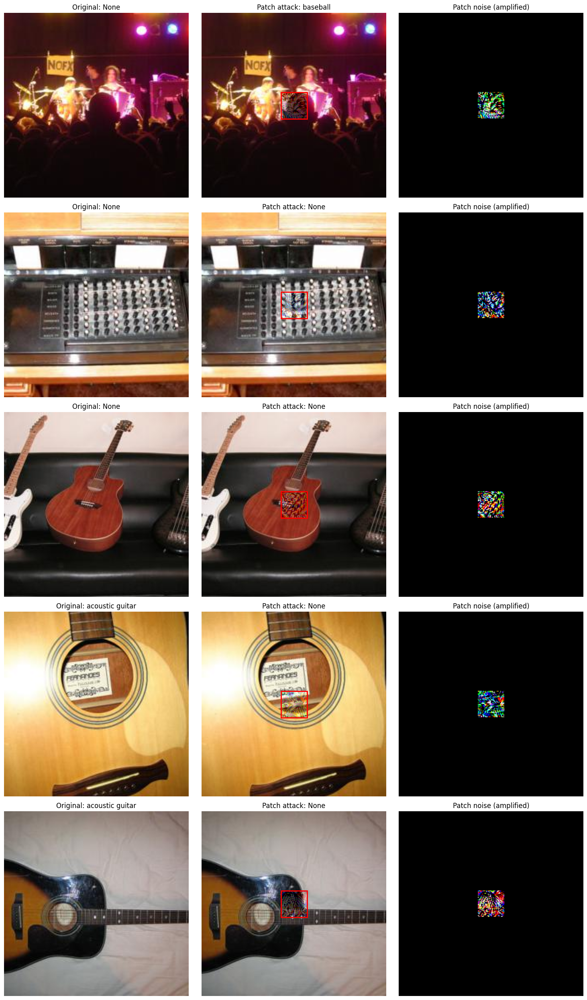

Task 4 completed with combined method!


In [44]:
# Task 4: 结合LaVAN和之前方法的高级补丁攻击

# 创建保存对抗样本的目录
adv_dir3 = "./AdversarialTestSet3"
os.makedirs(adv_dir3, exist_ok=True)

# 创建与原始数据集相同的目录结构
for class_dir in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_dir)
    if os.path.isdir(class_path):
        os.makedirs(os.path.join(adv_dir3, class_dir), exist_ok=True)

# 参数设置
patch_size = 32
epsilon = 0.8          # 较大的epsilon（Task 4允许）
alpha = 0.06           # 适中的学习率
iterations = 80        # 充分的迭代次数
evaluation_percentage = 0.5  # 使用数据集的比例

def combined_patch_attack(image, label, patch_size, epsilon, alpha, iterations):
    """
    结合LaVAN论文和之前方法的高级补丁攻击
    1. 使用logit输出而非softmax后的概率
    2. 双目标损失函数：同时增加目标类别的logit和减少源类别的logit
    3. 使用学习率调度和动量
    4. 高对比度的初始化
    """
    # 获取图像尺寸
    _, _, height, width = image.shape
    
    # 补丁位置 - 使用图像中心（通常更有效）
    top = (height - patch_size) // 2
    left = (width - patch_size) // 2
    
    # 创建补丁掩码
    mask = torch.zeros_like(image).to(device)
    mask[:, :, top:top+patch_size, left:left+patch_size] = 1.0
    
    # 获取真实标签
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    # 获取源类别（当前模型对原始图像的预测）
    with torch.no_grad():
        original_output = pretrained_model(image)
        source_pred = torch.argmax(original_output, dim=1)
    
    # 选择目标类别（与源类别有明显差异的类别）
    target_class = (imagenet_label.item() + 500) % 1000
    target = torch.tensor([target_class]).to(device)
    
    # 创建初始扰动图像并使用高对比度模式初始化补丁区域
    perturbed_image = image.clone().detach()
    with torch.no_grad():
        # 创建一个对比度高的棋盘格模式
        check_size = 4  # 棋盘格中每个方格的大小
        for i in range(0, patch_size, check_size):
            for j in range(0, patch_size, check_size):
                if (i // check_size + j // check_size) % 2 == 0:
                    # 使用极端正值初始化通道
                    perturbed_image[:, :, top+i:min(top+i+check_size, top+patch_size), 
                                   left+j:min(left+j+check_size, left+patch_size)] = 2.0
                else:
                    # 使用极端负值初始化通道
                    perturbed_image[:, :, top+i:min(top+i+check_size, top+patch_size), 
                                   left+j:min(left+j+check_size, left+patch_size)] = -2.0
    
    # 学习率调度 - 开始较大，然后逐渐减小
    alphas = []
    for i in range(iterations):
        if i < iterations // 3:
            alphas.append(alpha)
        else:
            alphas.append(alpha * (0.9 ** ((i - iterations // 3) // 5)))
    
    # 使用动量优化
    grad_momentum = torch.zeros_like(image).to(device)
    momentum_weight = 0.9
    
    # 优化循环
    for i in range(iterations):
        # 设置requires_grad
        perturbed_image.requires_grad = True
        
        # 前向传播
        output = pretrained_model(perturbed_image)
        
        # 获取logit层输出（LaVAN方法的关键）
        logits = output
        
        # 计算双目标损失：
        # 1. 最大化目标类别的logit（负号使梯度下降最大化这个值）
        # 2. 最小化源类别的logit
        target_logit = logits[0, target_class]
        source_logit = logits[0, source_pred]
        
        # 随着迭代进行，调整目标权重
        target_weight = min(0.9, 0.3 + i / iterations * 0.6)
        loss = -(target_weight * target_logit - (1 - target_weight) * source_logit)
        
        # 梯度清零
        pretrained_model.zero_grad()
        
        # 计算梯度
        loss.backward()
        
        # 更新补丁区域
        with torch.no_grad():
            # 只获取补丁区域的梯度
            grad = perturbed_image.grad.data * mask
            
            # 更新动量项
            grad_momentum = momentum_weight * grad_momentum + grad / (torch.norm(grad, p=1) + 1e-10)
            
            # 使用当前学习率
            current_alpha = alphas[i]
            
            # 更新图像（仅补丁区域）
            perturbed_image = perturbed_image - current_alpha * torch.sign(grad_momentum)
            
            # 限制扰动在epsilon范围内
            delta = (perturbed_image - image) * mask
            delta = torch.clamp(delta, -epsilon, epsilon)
            perturbed_image = image + delta
            
            # 确保值在有效范围内
            for j, (m, s) in enumerate(zip(mean_norms, std_norms)):
                perturbed_image[:, j] = torch.clamp(perturbed_image[:, j], (0-m)/s, (1-m)/s)
        
        # 分离以准备下一次迭代
        perturbed_image = perturbed_image.detach()
    
    return perturbed_image, (top, left, top+patch_size, left+patch_size)

# 计算要评估的图像数量
total_dataset_size = len(dataset)
subset_size = int(total_dataset_size * evaluation_percentage)
print(f"Total dataset size: {total_dataset_size}")
print(f"Evaluating on subset of {subset_size} images ({evaluation_percentage*100:.0f}%)")

# 创建子集
subset_indices = list(range(subset_size))
subset_dataset = torch.utils.data.Subset(dataset, subset_indices)
subset_dataloader = DataLoader(subset_dataset, batch_size=1, shuffle=False)

# 跟踪指标
visualization_examples = []
num_examples = 0
original_correct_top1 = 0
original_correct_top5 = 0
adversarial_correct_top1 = 0
adversarial_correct_top5 = 0
total_images = 0

print("Starting combined patch attacks...")

for i, (image, label) in enumerate(subset_dataloader):
    if i % 10 == 0:  # 更频繁的进度更新
        print(f"Processing image {i}/{subset_size}...")
    
    image = image.to(device)
    label = label.to(device)
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    # 评估原始图像
    with torch.no_grad():
        original_output = pretrained_model(image)
        orig_top1, orig_pred_idx = compute_topk_accuracy(original_output, imagenet_label, k=1)
        orig_top5, _ = compute_topk_accuracy(original_output, imagenet_label, k=5)
        
        original_correct_top1 += orig_top1 / 100.0
        original_correct_top5 += orig_top5 / 100.0
    
    # 获取原始预测标签
    orig_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{orig_pred_idx}:"):
            orig_pred_label = entry.split(": ")[1]
            break
    
    # 应用组合补丁攻击
    perturbed_image, patch_coords = combined_patch_attack(image, label, patch_size, epsilon, alpha, iterations)
    
    # 重新分类扰动图像
    with torch.no_grad():
        adv_output = pretrained_model(perturbed_image)
        adv_top1, adv_pred_idx = compute_topk_accuracy(adv_output, imagenet_label, k=1)
        adv_top5, _ = compute_topk_accuracy(adv_output, imagenet_label, k=5)
        
        adversarial_correct_top1 += adv_top1 / 100.0
        adversarial_correct_top5 += adv_top5 / 100.0
    
    # 获取对抗预测标签
    adv_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{adv_pred_idx}:"):
            adv_pred_label = entry.split(": ")[1]
            break
    
    # 保存成功的攻击示例进行可视化
    if orig_pred_idx != adv_pred_idx and num_examples < 5:
        orig_img = denormalize(image.squeeze(0))
        adv_img = denormalize(perturbed_image.squeeze(0))
        
        # 创建补丁可视化
        top, left, bottom, right = patch_coords
        patch_vis = orig_img.clone()
        patch_vis[:, top:bottom, left:right] = adv_img[:, top:bottom, left:right]
        
        # 计算噪声并放大以提高可见度
        noise = torch.zeros_like(orig_img)
        noise[:, top:bottom, left:right] = (adv_img[:, top:bottom, left:right] - orig_img[:, top:bottom, left:right]) * 5
        
        visualization_examples.append({
            'original': orig_img,
            'adversarial': adv_img,
            'patch': patch_vis, 
            'noise': noise,
            'coords': patch_coords,
            'orig_label': orig_pred_label,
            'adv_label': adv_pred_label
        })
        num_examples += 1
    
    # 保存对抗样本
    orig_img_path = dataset.imgs[subset_indices[i]][0]
    class_dir = dataset.classes[label.item()]
    img_filename = os.path.basename(orig_img_path)
    adv_img_path = os.path.join(adv_dir3, class_dir, img_filename)
    
    # 转换为PIL并保存
    adv_img = denormalize(perturbed_image.squeeze(0))
    adv_img_pil = transforms.ToPILImage()(adv_img)
    adv_img_pil.save(adv_img_path)
    
    total_images += 1

# 计算准确率
original_top1_accuracy = 100 * original_correct_top1 / total_images
original_top5_accuracy = 100 * original_correct_top5 / total_images
adversarial_top1_accuracy = 100 * adversarial_correct_top1 / total_images
adversarial_top5_accuracy = 100 * adversarial_correct_top5 / total_images

print(f"[SUBSET EVALUATION] Original Top-1 Accuracy: {original_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Original Top-5 Accuracy: {original_top5_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Adversarial Top-1 Accuracy: {adversarial_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Adversarial Top-5 Accuracy: {adversarial_top5_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Accuracy drop (Top-1): {original_top1_accuracy - adversarial_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Accuracy drop (Top-5): {original_top5_accuracy - adversarial_top5_accuracy:.2f}%")

# 可视化
if visualization_examples:
    fig, axes = plt.subplots(len(visualization_examples), 3, figsize=(15, 5*len(visualization_examples)))
    
    for i, example in enumerate(visualization_examples):
        # 处理只有一个示例的情况
        if len(visualization_examples) == 1:
            ax_row = axes
        else:
            ax_row = axes[i]
            
        # 原始图像
        ax_row[0].imshow(example['original'].permute(1, 2, 0))
        ax_row[0].set_title(f"Original: {example['orig_label']}")
        ax_row[0].axis('off')
        
        # 补丁可视化
        ax_row[1].imshow(example['patch'].permute(1, 2, 0))
        top, left, bottom, right = example['coords']
        rect = plt.Rectangle((left, top), right-left, bottom-top, 
                            linewidth=2, edgecolor='red', facecolor='none')
        ax_row[1].add_patch(rect)
        ax_row[1].set_title(f"Patch attack: {example['adv_label']}")
        ax_row[1].axis('off')
        
        # 噪声可视化
        ax_row[2].imshow(example['noise'].permute(1, 2, 0))
        ax_row[2].set_title("Patch noise (amplified)")
        ax_row[2].axis('off')
    
    plt.tight_layout()
    plt.savefig("combined_patch_examples.png")
    plt.show()

print("Task 4 completed with combined method!")

Total dataset size: 500
Evaluating on subset of 250 images (50%)
Starting PS-GAN improved patch attacks...
Processing image 0/250...
Processing image 10/250...
Processing image 20/250...
Processing image 30/250...
Processing image 40/250...
Processing image 50/250...
Processing image 60/250...
Processing image 70/250...
Processing image 80/250...
Processing image 90/250...
Processing image 100/250...
Processing image 110/250...
Processing image 120/250...
Processing image 130/250...
Processing image 140/250...
Processing image 150/250...
Processing image 160/250...
Processing image 170/250...
Processing image 180/250...
Processing image 190/250...
Processing image 200/250...
Processing image 210/250...
Processing image 220/250...
Processing image 230/250...
Processing image 240/250...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877502..1.0877502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877502..1.0877502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877502..1.0877502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877501..1.0877502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877502..1.0877502].


[SUBSET EVALUATION] Original Top-1 Accuracy: 79.20%
[SUBSET EVALUATION] Original Top-5 Accuracy: 96.40%
[SUBSET EVALUATION] Adversarial Top-1 Accuracy: 24.40%
[SUBSET EVALUATION] Adversarial Top-5 Accuracy: 45.60%
[SUBSET EVALUATION] Accuracy drop (Top-1): 54.80%
[SUBSET EVALUATION] Accuracy drop (Top-5): 50.80%


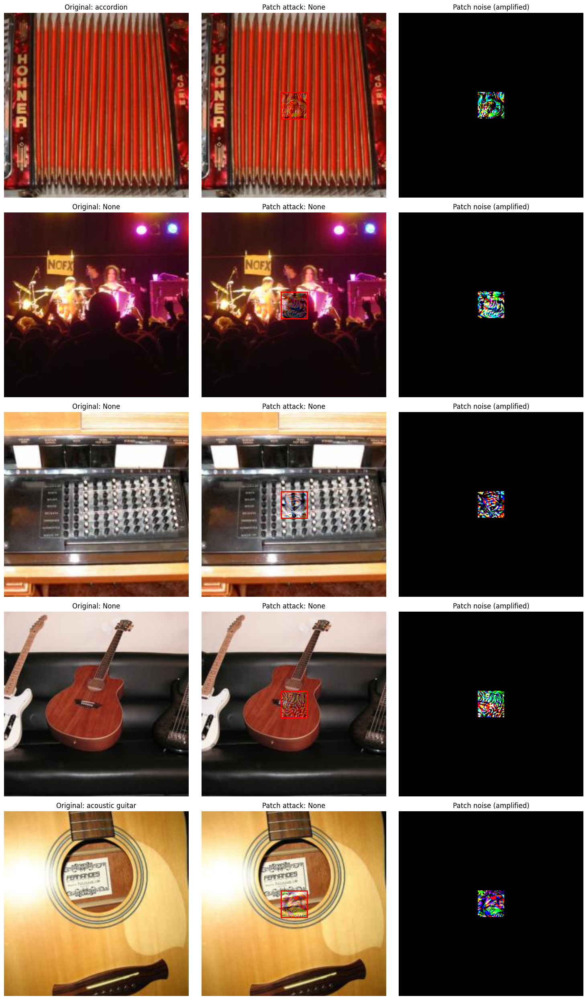

Task 4 completed with PS-GAN improved method!


In [48]:
# Task 4: 基于PS-GAN思想的改进版补丁攻击

# 创建保存对抗样本的目录
adv_dir3 = "./AdversarialTestSet3"
os.makedirs(adv_dir3, exist_ok=True)

# 创建与原始数据集相同的目录结构
for class_dir in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_dir)
    if os.path.isdir(class_path):
        os.makedirs(os.path.join(adv_dir3, class_dir), exist_ok=True)

# 参数设置
patch_size = 32
epsilon = 0.95         # 较大的epsilon
alpha = 0.1            # 较大的学习率
iterations = 100       # 更多迭代次数
evaluation_percentage = 0.5  # 使用数据集的比例

def psgan_improved_attack(image, label, patch_size, epsilon, alpha, iterations):
    """
    基于PS-GAN论文思想改进的补丁攻击
    
    关键特点：
    1. 使用logit层输出进行优化
    2. 多组件损失函数（视觉保真度 + 攻击能力）
    3. 余弦退火学习率调度
    4. 改进的补丁初始化
    """
    # 获取图像尺寸
    _, _, height, width = image.shape
    
    # 补丁位置 - 使用图像中心
    top = (height - patch_size) // 2
    left = (width - patch_size) // 2
    
    # 创建补丁掩码
    mask = torch.zeros_like(image).to(device)
    mask[:, :, top:top+patch_size, left:left+patch_size] = 1.0
    
    # 获取真实标签和源预测
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    with torch.no_grad():
        original_output = pretrained_model(image)
        source_pred = torch.argmax(original_output, dim=1)
    
    # 选择目标类 - 与源类别有明显差异的类别
    target_class = (imagenet_label.item() + 500) % 1000
    target = torch.tensor([target_class]).to(device)
    
    # 初始化补丁 - 使用特殊模式而非简单棋盘格
    perturbed_image = image.clone().detach()
    with torch.no_grad():
        # 创建一个径向渐变模式，从中心向外
        for c in range(3):  # 对每个颜色通道
            for i in range(patch_size):
                for j in range(patch_size):
                    # 计算到中心的距离
                    distance = np.sqrt((i - patch_size/2)**2 + (j - patch_size/2)**2) / (patch_size/2)
                    # 生成正弦波模式
                    val = np.sin(distance * 5 * np.pi + c * 2.0 * np.pi / 3)
                    # 将值缩放到[-1, 1]范围
                    pixel_val = val * 1.5  # 使用更大的初始扰动
                    perturbed_image[:, c, top+i, left+j] = pixel_val
    
    # 使用动量优化
    grad_momentum = torch.zeros_like(image).to(device)
    momentum_weight = 0.9
    
    # 余弦退火学习率调度
    alphas = []
    for i in range(iterations):
        if i < iterations // 3:
            # 开始阶段使用较大学习率
            alphas.append(alpha * 1.2)
        else:
            # 后期使用余弦退火
            factor = 0.5 * (1 + np.cos(np.pi * (i - iterations // 3) / (iterations - iterations // 3)))
            alphas.append(alpha * factor)
    
    # 优化循环
    for i in range(iterations):
        perturbed_image.requires_grad = True
        
        # 前向传播
        output = pretrained_model(perturbed_image)
        
        # 使用logit输出（按PS-GAN论文建议）
        logits = output
        
        # 多组件损失计算
        
        # 1. 视觉保真度损失 - 限制补丁与原始图像的差异
        # 使用L2范数计算补丁区域的平方差
        patch_area_orig = image * mask
        patch_area_pert = perturbed_image * mask
        visual_fidelity_loss = torch.sum((patch_area_pert - patch_area_orig) ** 2) / torch.sum(mask)
        
        # 2. 攻击能力损失 - 增加目标类别logit并降低源类别logit
        target_logit = logits[0, target_class]
        source_logit = logits[0, source_pred]
        
        # 获取其他top-k类别的logit值
        topk = 5
        values, indices = torch.topk(logits[0], k=topk)
        other_logits = torch.sum(values * ((indices != target_class) & (indices != source_pred[0])).float())
        
        # 完整的攻击损失 - 增加目标类logit，降低源类和其他类logit
        attack_loss = -target_logit + 0.5 * source_logit + 0.1 * other_logits
        
        # 动态调整损失权重 - 随着迭代进行，增加攻击损失的权重
        # 前期关注视觉保真度，后期关注攻击能力
        attack_weight = min(0.9, 0.3 + i / iterations * 0.6)
        loss = attack_weight * attack_loss + (1 - attack_weight) * visual_fidelity_loss
        
        # 梯度清零
        pretrained_model.zero_grad()
        
        # 计算梯度
        loss.backward()
        
        # 更新补丁区域
        with torch.no_grad():
            # 只获取补丁区域的梯度
            grad = perturbed_image.grad.data * mask
            
            # 添加随机噪声帮助逃离局部最小值（初期迭代中）
            if i < iterations // 3 and i % 10 == 0:
                noise = torch.randn_like(grad) * alpha * 0.05
                grad = grad + noise * mask
            
            # 更新动量项
            grad_momentum = momentum_weight * grad_momentum + grad / (torch.norm(grad, p=1) + 1e-10)
            
            # 使用当前学习率
            current_alpha = alphas[i]
            
            # 更新图像
            perturbed_image = perturbed_image - current_alpha * torch.sign(grad_momentum)
            
            # 限制扰动在epsilon范围内
            delta = (perturbed_image - image) * mask
            delta = torch.clamp(delta, -epsilon, epsilon)
            perturbed_image = image + delta
            
            # 确保值在有效范围内
            for j, (m, s) in enumerate(zip(mean_norms, std_norms)):
                perturbed_image[:, j] = torch.clamp(perturbed_image[:, j], (0-m)/s, (1-m)/s)
        
        # 分离以准备下一次迭代
        perturbed_image = perturbed_image.detach()
    
    return perturbed_image, (top, left, top+patch_size, left+patch_size)

# 计算要评估的图像数量
total_dataset_size = len(dataset)
subset_size = int(total_dataset_size * evaluation_percentage)
print(f"Total dataset size: {total_dataset_size}")
print(f"Evaluating on subset of {subset_size} images ({evaluation_percentage*100:.0f}%)")

# 创建子集
subset_indices = list(range(subset_size))
subset_dataset = torch.utils.data.Subset(dataset, subset_indices)
subset_dataloader = DataLoader(subset_dataset, batch_size=1, shuffle=False)

# 跟踪指标
visualization_examples = []
num_examples = 0
original_correct_top1 = 0
original_correct_top5 = 0
adversarial_correct_top1 = 0
adversarial_correct_top5 = 0
total_images = 0

print("Starting PS-GAN improved patch attacks...")

for i, (image, label) in enumerate(subset_dataloader):
    if i % 10 == 0:
        print(f"Processing image {i}/{subset_size}...")
    
    image = image.to(device)
    label = label.to(device)
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    # 评估原始图像
    with torch.no_grad():
        original_output = pretrained_model(image)
        orig_top1, orig_pred_idx = compute_topk_accuracy(original_output, imagenet_label, k=1)
        orig_top5, _ = compute_topk_accuracy(original_output, imagenet_label, k=5)
        
        original_correct_top1 += orig_top1 / 100.0
        original_correct_top5 += orig_top5 / 100.0
    
    # 获取原始预测标签
    orig_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{orig_pred_idx}:"):
            orig_pred_label = entry.split(": ")[1]
            break
    
    # 应用PS-GAN改进的补丁攻击
    perturbed_image, patch_coords = psgan_improved_attack(image, label, patch_size, epsilon, alpha, iterations)
    
    # 重新分类扰动图像
    with torch.no_grad():
        adv_output = pretrained_model(perturbed_image)
        adv_top1, adv_pred_idx = compute_topk_accuracy(adv_output, imagenet_label, k=1)
        adv_top5, _ = compute_topk_accuracy(adv_output, imagenet_label, k=5)
        
        adversarial_correct_top1 += adv_top1 / 100.0
        adversarial_correct_top5 += adv_top5 / 100.0
    
    # 获取对抗预测标签
    adv_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{adv_pred_idx}:"):
            adv_pred_label = entry.split(": ")[1]
            break
    
    # 保存成功的攻击示例进行可视化
    if orig_pred_idx != adv_pred_idx and num_examples < 5:
        orig_img = denormalize(image.squeeze(0))
        adv_img = denormalize(perturbed_image.squeeze(0))
        
        # 创建补丁可视化
        top, left, bottom, right = patch_coords
        patch_vis = orig_img.clone()
        patch_vis[:, top:bottom, left:right] = adv_img[:, top:bottom, left:right]
        
        # 计算噪声并放大以提高可见度
        noise = torch.zeros_like(orig_img)
        noise[:, top:bottom, left:right] = (adv_img[:, top:bottom, left:right] - orig_img[:, top:bottom, left:right]) * 5
        
        visualization_examples.append({
            'original': orig_img,
            'adversarial': adv_img,
            'patch': patch_vis, 
            'noise': noise,
            'coords': patch_coords,
            'orig_label': orig_pred_label,
            'adv_label': adv_pred_label
        })
        num_examples += 1
    
    # 保存对抗样本
    orig_img_path = dataset.imgs[subset_indices[i]][0]
    class_dir = dataset.classes[label.item()]
    img_filename = os.path.basename(orig_img_path)
    adv_img_path = os.path.join(adv_dir3, class_dir, img_filename)
    
    # 转换为PIL并保存
    adv_img = denormalize(perturbed_image.squeeze(0))
    adv_img_pil = transforms.ToPILImage()(adv_img)
    adv_img_pil.save(adv_img_path)
    
    total_images += 1

# 计算准确率
original_top1_accuracy = 100 * original_correct_top1 / total_images
original_top5_accuracy = 100 * original_correct_top5 / total_images
adversarial_top1_accuracy = 100 * adversarial_correct_top1 / total_images
adversarial_top5_accuracy = 100 * adversarial_correct_top5 / total_images

print(f"[SUBSET EVALUATION] Original Top-1 Accuracy: {original_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Original Top-5 Accuracy: {original_top5_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Adversarial Top-1 Accuracy: {adversarial_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Adversarial Top-5 Accuracy: {adversarial_top5_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Accuracy drop (Top-1): {original_top1_accuracy - adversarial_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Accuracy drop (Top-5): {original_top5_accuracy - adversarial_top5_accuracy:.2f}%")

# 可视化
if visualization_examples:
    fig, axes = plt.subplots(len(visualization_examples), 3, figsize=(15, 5*len(visualization_examples)))
    
    for i, example in enumerate(visualization_examples):
        # 处理只有一个示例的情况
        if len(visualization_examples) == 1:
            ax_row = axes
        else:
            ax_row = axes[i]
            
        # 原始图像
        ax_row[0].imshow(example['original'].permute(1, 2, 0))
        ax_row[0].set_title(f"Original: {example['orig_label']}")
        ax_row[0].axis('off')
        
        # 补丁可视化
        ax_row[1].imshow(example['patch'].permute(1, 2, 0))
        top, left, bottom, right = example['coords']
        rect = plt.Rectangle((left, top), right-left, bottom-top, 
                            linewidth=2, edgecolor='red', facecolor='none')
        ax_row[1].add_patch(rect)
        ax_row[1].set_title(f"Patch attack: {example['adv_label']}")
        ax_row[1].axis('off')
        
        # 噪声可视化
        ax_row[2].imshow(example['noise'].permute(1, 2, 0))
        ax_row[2].set_title("Patch noise (amplified)")
        ax_row[2].axis('off')
    
    plt.tight_layout()
    plt.savefig("psgan_improved_patch_examples.png")
    plt.show()

print("Task 4 completed with PS-GAN improved method!")

Total dataset size: 500
Evaluating on subset of 250 images (50%)
Starting improved PS-GAN patch attacks with optimal location...
Processing image 0/250...
Processing image 10/250...
Processing image 20/250...
Processing image 30/250...
Processing image 40/250...
Processing image 50/250...
Processing image 60/250...
Processing image 70/250...
Processing image 80/250...
Processing image 90/250...
Processing image 100/250...
Processing image 110/250...
Processing image 120/250...
Processing image 130/250...
Processing image 140/250...
Processing image 150/250...
Processing image 160/250...
Processing image 170/250...
Processing image 180/250...
Processing image 190/250...
Processing image 200/250...
Processing image 210/250...
Processing image 220/250...
Processing image 230/250...
Processing image 240/250...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.50481427..1.0877501].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877501..1.0877501].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877502..1.0877502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877501..1.0877502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877501..1.0877502].


[SUBSET EVALUATION] Original Top-1 Accuracy: 79.20%
[SUBSET EVALUATION] Original Top-5 Accuracy: 96.40%
[SUBSET EVALUATION] Adversarial Top-1 Accuracy: 32.40%
[SUBSET EVALUATION] Adversarial Top-5 Accuracy: 51.20%
[SUBSET EVALUATION] Accuracy drop (Top-1): 46.80%
[SUBSET EVALUATION] Accuracy drop (Top-5): 45.20%


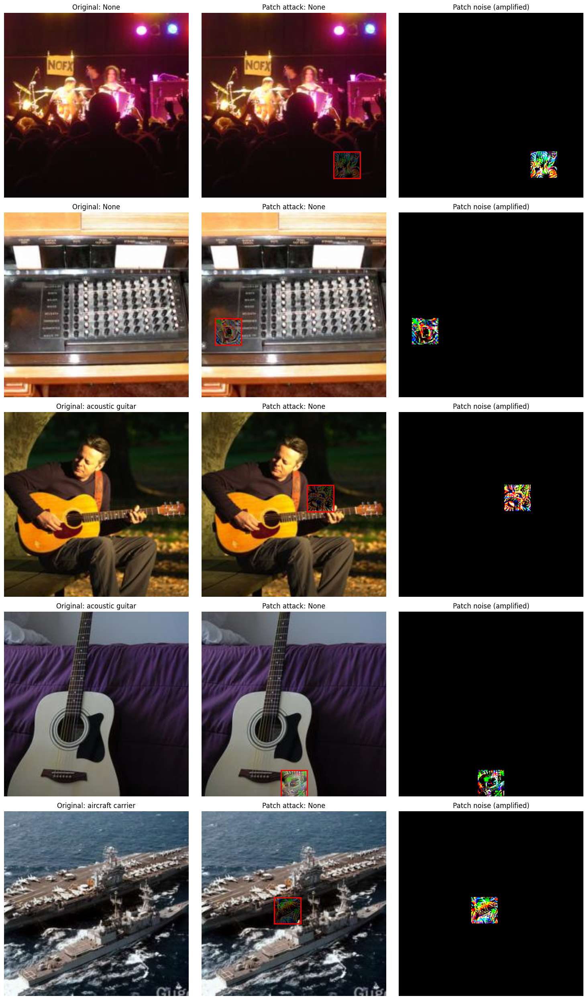

Task 4 completed with improved PS-GAN method with optimal location!


In [56]:
# Task 4: 基于PS-GAN思想的改进版补丁攻击（加入脆弱性位置选择）

# 创建保存对抗样本的目录
adv_dir3 = "./AdversarialTestSet3"
os.makedirs(adv_dir3, exist_ok=True)

# 创建与原始数据集相同的目录结构
for class_dir in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_dir)
    if os.path.isdir(class_path):
        os.makedirs(os.path.join(adv_dir3, class_dir), exist_ok=True)

# 参数设置
patch_size = 32
epsilon = 0.95         # 较大的epsilon
alpha = 0.1            # 较大的学习率
iterations = 100       # 更多迭代次数
evaluation_percentage = 0.5  # 使用数据集的比例

# 添加脆弱性位置查找功能
def find_optimal_patch_location(image, model, patch_size):
    """
    快速确定对抗补丁的最佳位置 - 基于脆弱性分析
    """
    # 获取图像尺寸
    _, _, height, width = image.shape
    
    # 默认位置 - 图像中心
    default_position = (height // 2 - patch_size // 2, width // 2 - patch_size // 2)
    
    try:
        with torch.enable_grad():
            # 确保图像需要梯度
            image.requires_grad_(True)
            
            # 前向传播获取预测结果
            output = model(image)
            
            # 获取预测类别
            pred_class = torch.argmax(output, dim=1)
            
            # 对预测类别的分数计算梯度
            model.zero_grad()
            output[0, pred_class].backward()
            
            # 获取输入梯度的绝对值
            gradient = torch.abs(image.grad.data).sum(dim=1).squeeze().cpu().numpy()
            
            # 使用滑动窗口找到重要性最高的区域
            max_importance = -float('inf')
            optimal_position = default_position
            
            # 使用步长减少计算量
            step = max(1, patch_size // 4)
            
            for i in range(0, height - patch_size + 1, step):
                for j in range(0, width - patch_size + 1, step):
                    # 计算当前窗口的重要性分数
                    window_score = np.sum(gradient[i:i+patch_size, j:j+patch_size])
                    if window_score > max_importance:
                        max_importance = window_score
                        optimal_position = (i, j)
            
            # 返回找到的最优位置
            return optimal_position
            
    except Exception as e:
        print(f"Error in finding optimal position: {e}, using default position")
        return default_position

def psgan_improved_attack(image, label, patch_size, epsilon, alpha, iterations):
    """
    基于PS-GAN论文思想改进的补丁攻击
    
    关键特点：
    1. 使用脆弱性分析选择最优补丁位置
    2. 使用logit层输出进行优化
    3. 多组件损失函数（视觉保真度 + 攻击能力）
    4. 余弦退火学习率调度
    5. 改进的补丁初始化
    """
    # 获取图像尺寸
    _, _, height, width = image.shape
    
    # 使用脆弱性位置查找
    top, left = find_optimal_patch_location(image, pretrained_model, patch_size)
    
    # 创建补丁掩码
    mask = torch.zeros_like(image).to(device)
    mask[:, :, top:top+patch_size, left:left+patch_size] = 1.0
    
    # 获取真实标签和源预测
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    with torch.no_grad():
        original_output = pretrained_model(image)
        source_pred = torch.argmax(original_output, dim=1)
    
    # 选择目标类 - 使用最不可能的类别作为目标
    probs = torch.nn.functional.softmax(original_output, dim=1)
    _, least_likely_indices = torch.topk(probs[0], k=5, largest=False)
    target_class = least_likely_indices[0].item()
    target = torch.tensor([target_class]).to(device)
    
    # 初始化补丁 - 使用特殊模式而非简单棋盘格
    perturbed_image = image.clone().detach()
    with torch.no_grad():
        # 创建一个径向渐变模式，从中心向外
        for c in range(3):  # 对每个颜色通道
            for i in range(patch_size):
                for j in range(patch_size):
                    # 计算到中心的距离
                    distance = np.sqrt((i - patch_size/2)**2 + (j - patch_size/2)**2) / (patch_size/2)
                    # 生成正弦波模式
                    val = np.sin(distance * 5 * np.pi + c * 2.0 * np.pi / 3)
                    # 将值缩放到[-1, 1]范围
                    pixel_val = val * 1.5  # 使用更大的初始扰动
                    perturbed_image[:, c, top+i, left+j] = pixel_val
    
    # 使用动量优化
    grad_momentum = torch.zeros_like(image).to(device)
    momentum_weight = 0.9
    
    # 余弦退火学习率调度
    alphas = []
    for i in range(iterations):
        if i < iterations // 3:
            # 开始阶段使用较大学习率
            alphas.append(alpha * 1.2)
        else:
            # 后期使用余弦退火
            factor = 0.5 * (1 + np.cos(np.pi * (i - iterations // 3) / (iterations - iterations // 3)))
            alphas.append(alpha * factor)
    
    # 优化循环
    for i in range(iterations):
        perturbed_image.requires_grad = True
        
        # 前向传播
        output = pretrained_model(perturbed_image)
        
        # 使用logit输出（按PS-GAN论文建议）
        logits = output
        
        # 多组件损失计算
        
        # 1. 视觉保真度损失 - 限制补丁与原始图像的差异
        # 使用L2范数计算补丁区域的平方差
        patch_area_orig = image * mask
        patch_area_pert = perturbed_image * mask
        visual_fidelity_loss = torch.sum((patch_area_pert - patch_area_orig) ** 2) / torch.sum(mask)
        
        # 2. 攻击能力损失 - 增加目标类别logit并降低源类别logit
        target_logit = logits[0, target_class]
        source_logit = logits[0, source_pred]
        
        # 获取其他top-k类别的logit值
        topk = 5
        values, indices = torch.topk(logits[0], k=topk)
        other_logits = torch.sum(values * ((indices != target_class) & (indices != source_pred[0])).float())
        
        # 完整的攻击损失 - 增加目标类logit，降低源类和其他类logit
        attack_loss = -target_logit + 0.5 * source_logit + 0.1 * other_logits
        
        # 3. 总变分损失 - 平滑补丁纹理
        patch = perturbed_image[:, :, top:top+patch_size, left:left+patch_size]
        tv_loss = torch.sum(torch.abs(patch[:, :, :, :-1] - patch[:, :, :, 1:])) + \
                 torch.sum(torch.abs(patch[:, :, :-1, :] - patch[:, :, 1:, :]))
        tv_loss = tv_loss / (patch_size * patch_size)
        
        # 动态调整损失权重 - 随着迭代进行，增加攻击损失的权重
        # 前期关注视觉保真度，后期关注攻击能力
        attack_weight = min(0.85, 0.3 + i / iterations * 0.55)
        tv_weight = 0.05
        fidelity_weight = 1.0 - attack_weight - tv_weight
        
        # 计算总损失
        loss = attack_weight * attack_loss + fidelity_weight * visual_fidelity_loss + tv_weight * tv_loss
        
        # 梯度清零
        pretrained_model.zero_grad()
        
        # 计算梯度
        loss.backward()
        
        # 更新补丁区域
        with torch.no_grad():
            # 只获取补丁区域的梯度
            grad = perturbed_image.grad.data * mask
            
            # 添加随机噪声帮助逃离局部最小值（初期迭代中）
            if i < iterations // 3 and i % 10 == 0:
                noise = torch.randn_like(grad) * alpha * 0.05
                grad = grad + noise * mask
            
            # 更新动量项
            grad_momentum = momentum_weight * grad_momentum + grad / (torch.norm(grad, p=1) + 1e-10)
            
            # 使用当前学习率
            current_alpha = alphas[i]
            
            # 更新图像
            perturbed_image = perturbed_image - current_alpha * torch.sign(grad_momentum)
            
            # 限制扰动在epsilon范围内
            delta = (perturbed_image - image) * mask
            delta = torch.clamp(delta, -epsilon, epsilon)
            perturbed_image = image + delta
            
            # 确保值在有效范围内
            for j, (m, s) in enumerate(zip(mean_norms, std_norms)):
                perturbed_image[:, j] = torch.clamp(perturbed_image[:, j], (0-m)/s, (1-m)/s)
        
        # 分离以准备下一次迭代
        perturbed_image = perturbed_image.detach()
    
    return perturbed_image, (top, left, top+patch_size, left+patch_size)

# 计算要评估的图像数量
total_dataset_size = len(dataset)
subset_size = int(total_dataset_size * evaluation_percentage)
print(f"Total dataset size: {total_dataset_size}")
print(f"Evaluating on subset of {subset_size} images ({evaluation_percentage*100:.0f}%)")

# 创建子集
subset_indices = list(range(subset_size))
subset_dataset = torch.utils.data.Subset(dataset, subset_indices)
subset_dataloader = DataLoader(subset_dataset, batch_size=1, shuffle=False)

# 跟踪指标
visualization_examples = []
num_examples = 0
original_correct_top1 = 0
original_correct_top5 = 0
adversarial_correct_top1 = 0
adversarial_correct_top5 = 0
total_images = 0

print("Starting improved PS-GAN patch attacks with optimal location...")

for i, (image, label) in enumerate(subset_dataloader):
    if i % 10 == 0:
        print(f"Processing image {i}/{subset_size}...")
    
    image = image.to(device)
    label = label.to(device)
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    # 评估原始图像
    with torch.no_grad():
        original_output = pretrained_model(image)
        orig_top1, orig_pred_idx = compute_topk_accuracy(original_output, imagenet_label, k=1)
        orig_top5, _ = compute_topk_accuracy(original_output, imagenet_label, k=5)
        
        original_correct_top1 += orig_top1 / 100.0
        original_correct_top5 += orig_top5 / 100.0
    
    # 获取原始预测标签
    orig_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{orig_pred_idx}:"):
            orig_pred_label = entry.split(": ")[1]
            break
    
    # 应用改进的PS-GAN补丁攻击
    perturbed_image, patch_coords = psgan_improved_attack(image, label, patch_size, epsilon, alpha, iterations)
    
    # 重新分类扰动图像
    with torch.no_grad():
        adv_output = pretrained_model(perturbed_image)
        adv_top1, adv_pred_idx = compute_topk_accuracy(adv_output, imagenet_label, k=1)
        adv_top5, _ = compute_topk_accuracy(adv_output, imagenet_label, k=5)
        
        adversarial_correct_top1 += adv_top1 / 100.0
        adversarial_correct_top5 += adv_top5 / 100.0
    
    # 获取对抗预测标签
    adv_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{adv_pred_idx}:"):
            adv_pred_label = entry.split(": ")[1]
            break
    
    # 保存成功的攻击示例进行可视化
    if orig_pred_idx != adv_pred_idx and num_examples < 5:
        orig_img = denormalize(image.squeeze(0))
        adv_img = denormalize(perturbed_image.squeeze(0))
        
        # 创建补丁可视化
        top, left, bottom, right = patch_coords
        patch_vis = orig_img.clone()
        patch_vis[:, top:bottom, left:right] = adv_img[:, top:bottom, left:right]
        
        # 计算噪声并放大以提高可见度
        noise = torch.zeros_like(orig_img)
        noise[:, top:bottom, left:right] = (adv_img[:, top:bottom, left:right] - orig_img[:, top:bottom, left:right]) * 5
        
        visualization_examples.append({
            'original': orig_img,
            'adversarial': adv_img,
            'patch': patch_vis, 
            'noise': noise,
            'coords': patch_coords,
            'orig_label': orig_pred_label,
            'adv_label': adv_pred_label
        })
        num_examples += 1
    
    # 保存对抗样本
    orig_img_path = dataset.imgs[subset_indices[i]][0]
    class_dir = dataset.classes[label.item()]
    img_filename = os.path.basename(orig_img_path)
    adv_img_path = os.path.join(adv_dir3, class_dir, img_filename)
    
    # 转换为PIL并保存
    adv_img = denormalize(perturbed_image.squeeze(0))
    adv_img_pil = transforms.ToPILImage()(adv_img)
    adv_img_pil.save(adv_img_path)
    
    total_images += 1

# 计算准确率
original_top1_accuracy = 100 * original_correct_top1 / total_images
original_top5_accuracy = 100 * original_correct_top5 / total_images
adversarial_top1_accuracy = 100 * adversarial_correct_top1 / total_images
adversarial_top5_accuracy = 100 * adversarial_correct_top5 / total_images

print(f"[SUBSET EVALUATION] Original Top-1 Accuracy: {original_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Original Top-5 Accuracy: {original_top5_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Adversarial Top-1 Accuracy: {adversarial_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Adversarial Top-5 Accuracy: {adversarial_top5_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Accuracy drop (Top-1): {original_top1_accuracy - adversarial_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Accuracy drop (Top-5): {original_top5_accuracy - adversarial_top5_accuracy:.2f}%")

# 可视化
if visualization_examples:
    fig, axes = plt.subplots(len(visualization_examples), 3, figsize=(15, 5*len(visualization_examples)))
    
    for i, example in enumerate(visualization_examples):
        # 处理只有一个示例的情况
        if len(visualization_examples) == 1:
            ax_row = axes
        else:
            ax_row = axes[i]
            
        # 原始图像
        ax_row[0].imshow(example['original'].permute(1, 2, 0))
        ax_row[0].set_title(f"Original: {example['orig_label']}")
        ax_row[0].axis('off')
        
        # 补丁可视化
        ax_row[1].imshow(example['patch'].permute(1, 2, 0))
        top, left, bottom, right = example['coords']
        rect = plt.Rectangle((left, top), right-left, bottom-top, 
                            linewidth=2, edgecolor='red', facecolor='none')
        ax_row[1].add_patch(rect)
        ax_row[1].set_title(f"Patch attack: {example['adv_label']}")
        ax_row[1].axis('off')
        
        # 噪声可视化
        ax_row[2].imshow(example['noise'].permute(1, 2, 0))
        ax_row[2].set_title("Patch noise (amplified)")
        ax_row[2].axis('off')
    
    plt.tight_layout()
    plt.savefig("psgan_improved_optimal_location_examples.png")
    plt.show()

print("Task 4 completed with improved PS-GAN method with optimal location!")

Total dataset size: 500
Evaluating on subset of 250 images (50%)
Using position strategy: hybrid
Starting improved PS-GAN patch attacks with hybrid location strategy...
Processing image 0/250...
Processing image 10/250...
Processing image 20/250...
Processing image 30/250...
Processing image 40/250...
Processing image 50/250...
Processing image 60/250...
Processing image 70/250...
Processing image 80/250...
Processing image 90/250...
Processing image 100/250...
Processing image 110/250...
Processing image 120/250...
Processing image 130/250...
Processing image 140/250...
Processing image 150/250...
Processing image 160/250...
Processing image 170/250...
Processing image 180/250...
Processing image 190/250...
Processing image 200/250...
Processing image 210/250...
Processing image 220/250...
Processing image 230/250...
Processing image 240/250...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.5098039..1.0877501].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877501..1.0877501].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877501..1.0877501].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877502..1.0687501].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0877502..1.0877502].


[SUBSET EVALUATION] Original Top-1 Accuracy: 79.20%
[SUBSET EVALUATION] Original Top-5 Accuracy: 96.40%
[SUBSET EVALUATION] Adversarial Top-1 Accuracy: 32.80%
[SUBSET EVALUATION] Adversarial Top-5 Accuracy: 50.80%
[SUBSET EVALUATION] Accuracy drop (Top-1): 46.40%
[SUBSET EVALUATION] Accuracy drop (Top-5): 45.60%


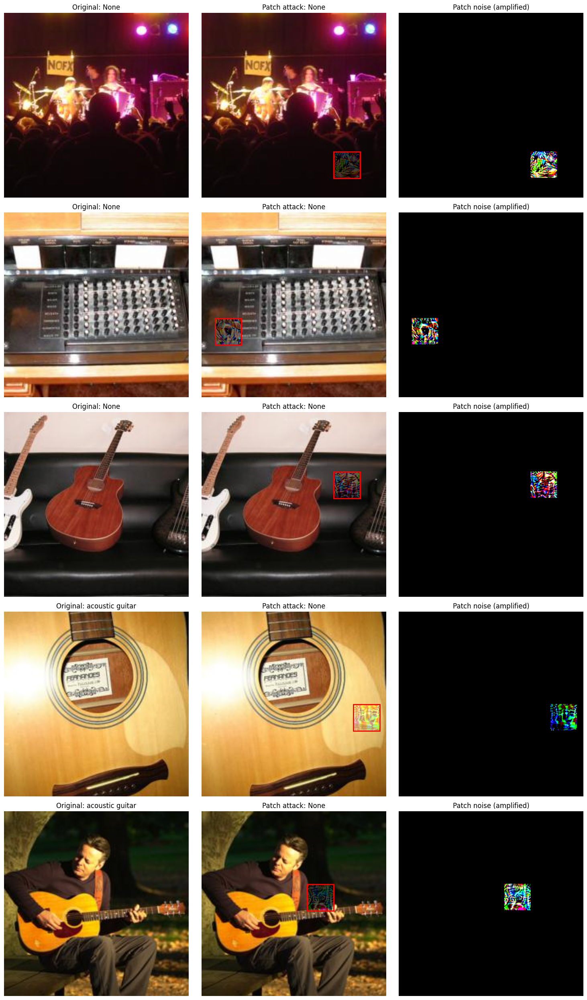

Task 4 completed with improved PS-GAN method with hybrid location strategy!


In [57]:
# Task 4: 基于PS-GAN思想的改进版补丁攻击（混合位置选择）

# 创建保存对抗样本的目录
adv_dir3 = "./AdversarialTestSet3"
os.makedirs(adv_dir3, exist_ok=True)

# 创建与原始数据集相同的目录结构
for class_dir in os.listdir(dataset_path):
    class_path = os.path.join(dataset_path, class_dir)
    if os.path.isdir(class_path):
        os.makedirs(os.path.join(adv_dir3, class_dir), exist_ok=True)

# 参数设置
patch_size = 32
epsilon = 0.95         # 较大的epsilon
alpha = 0.1            # 较大的学习率
iterations = 100       # 更多迭代次数
evaluation_percentage = 0.5  # 使用数据集的比例

# 可选的补丁位置策略
POSITION_STRATEGY = "hybrid"  # 可以设置为: "center", "vulnerability", "hybrid"

# 添加脆弱性位置查找功能
def find_optimal_patch_location(image, model, patch_size):
    """
    快速确定对抗补丁的最佳位置 - 基于脆弱性分析
    """
    # 获取图像尺寸
    _, _, height, width = image.shape
    
    # 默认位置 - 图像中心
    default_position = (height // 2 - patch_size // 2, width // 2 - patch_size // 2)
    
    # 如果策略是仅使用中心位置，直接返回
    if POSITION_STRATEGY == "center":
        return default_position
    
    try:
        with torch.enable_grad():
            # 确保图像需要梯度
            image.requires_grad_(True)
            
            # 前向传播获取预测结果
            output = model(image)
            
            # 获取预测类别
            pred_class = torch.argmax(output, dim=1)
            
            # 对预测类别的分数计算梯度
            model.zero_grad()
            output[0, pred_class].backward()
            
            # 获取输入梯度的绝对值
            gradient = torch.abs(image.grad.data).sum(dim=1).squeeze().cpu().numpy()
            
            # 使用滑动窗口找到重要性最高的区域
            max_importance = -float('inf')
            optimal_position = default_position
            
            # 使用步长减少计算量
            step = max(1, patch_size // 4)
            
            for i in range(0, height - patch_size + 1, step):
                for j in range(0, width - patch_size + 1, step):
                    # 计算当前窗口的重要性分数
                    window_score = np.sum(gradient[i:i+patch_size, j:j+patch_size])
                    if window_score > max_importance:
                        max_importance = window_score
                        optimal_position = (i, j)
            
            # 如果是混合策略，评估中心位置和脆弱性位置
            if POSITION_STRATEGY == "hybrid":
                # 计算中心位置区域的脆弱性分数
                center_i, center_j = default_position
                center_score = np.sum(gradient[center_i:center_i+patch_size, center_j:center_j+patch_size])
                
                # 如果中心分数也很高（至少是最优分数的80%），则使用中心位置
                if center_score >= 0.8 * max_importance:
                    return default_position
            
            # 返回找到的最优位置
            return optimal_position
            
    except Exception as e:
        print(f"Error in finding optimal position: {e}, using default position")
        return default_position

def psgan_improved_attack(image, label, patch_size, epsilon, alpha, iterations):
    """
    基于PS-GAN论文思想改进的补丁攻击
    
    关键特点：
    1. 使用混合位置选择策略
    2. 使用logit层输出进行优化
    3. 多组件损失函数（视觉保真度 + 攻击能力）
    4. 余弦退火学习率调度
    5. 改进的补丁初始化
    """
    # 获取图像尺寸
    _, _, height, width = image.shape
    
    # 使用混合位置选择策略
    top, left = find_optimal_patch_location(image, pretrained_model, patch_size)
    
    # 创建补丁掩码
    mask = torch.zeros_like(image).to(device)
    mask[:, :, top:top+patch_size, left:left+patch_size] = 1.0
    
    # 获取真实标签和源预测
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    with torch.no_grad():
        original_output = pretrained_model(image)
        source_pred = torch.argmax(original_output, dim=1)
    
    # 目标类选择 - 结合固定偏移和最不可能类别
    if np.random.random() < 0.5:  # 50%概率使用固定偏移
        target_class = (imagenet_label.item() + 500) % 1000
    else:  # 50%概率使用最不可能类别
        probs = torch.nn.functional.softmax(original_output, dim=1)
        _, least_likely_indices = torch.topk(probs[0], k=5, largest=False)
        target_class = least_likely_indices[0].item()
    
    target = torch.tensor([target_class]).to(device)
    
    # 初始化补丁 - 使用特殊模式而非简单棋盘格
    perturbed_image = image.clone().detach()
    with torch.no_grad():
        # 创建一个径向渐变模式，从中心向外
        for c in range(3):  # 对每个颜色通道
            for i in range(patch_size):
                for j in range(patch_size):
                    # 计算到中心的距离
                    distance = np.sqrt((i - patch_size/2)**2 + (j - patch_size/2)**2) / (patch_size/2)
                    # 生成正弦波模式
                    val = np.sin(distance * 5 * np.pi + c * 2.0 * np.pi / 3)
                    # 将值缩放到[-1, 1]范围
                    pixel_val = val * 1.5  # 使用更大的初始扰动
                    perturbed_image[:, c, top+i, left+j] = pixel_val
    
    # 使用动量优化
    grad_momentum = torch.zeros_like(image).to(device)
    momentum_weight = 0.9
    
    # 余弦退火学习率调度
    alphas = []
    for i in range(iterations):
        if i < iterations // 3:
            # 开始阶段使用较大学习率
            alphas.append(alpha * 1.2)
        else:
            # 后期使用余弦退火
            factor = 0.5 * (1 + np.cos(np.pi * (i - iterations // 3) / (iterations - iterations // 3)))
            alphas.append(alpha * factor)
    
    # 优化循环
    for i in range(iterations):
        perturbed_image.requires_grad = True
        
        # 前向传播
        output = pretrained_model(perturbed_image)
        
        # 使用logit输出（按PS-GAN论文建议）
        logits = output
        
        # 多组件损失计算
        
        # 1. 视觉保真度损失 - 限制补丁与原始图像的差异
        # 使用L2范数计算补丁区域的平方差
        patch_area_orig = image * mask
        patch_area_pert = perturbed_image * mask
        visual_fidelity_loss = torch.sum((patch_area_pert - patch_area_orig) ** 2) / torch.sum(mask)
        
        # 2. 攻击能力损失 - 增加目标类别logit并降低源类别logit
        target_logit = logits[0, target_class]
        source_logit = logits[0, source_pred]
        
        # 获取其他top-k类别的logit值
        topk = 5
        values, indices = torch.topk(logits[0], k=topk)
        other_logits = torch.sum(values * ((indices != target_class) & (indices != source_pred[0])).float())
        
        # 完整的攻击损失 - 增加目标类logit，降低源类和其他类logit
        attack_loss = -target_logit + 0.5 * source_logit + 0.1 * other_logits
        
        # 3. 总变分损失 - 平滑补丁纹理
        patch = perturbed_image[:, :, top:top+patch_size, left:left+patch_size]
        tv_loss = torch.sum(torch.abs(patch[:, :, :, :-1] - patch[:, :, :, 1:])) + \
                 torch.sum(torch.abs(patch[:, :, :-1, :] - patch[:, :, 1:, :]))
        tv_loss = tv_loss / (patch_size * patch_size)
        
        # 动态调整损失权重 - 随着迭代进行，增加攻击损失的权重
        # 前期关注视觉保真度，后期关注攻击能力
        attack_weight = min(0.9, 0.3 + i / iterations * 0.6)
        tv_weight = 0.05
        fidelity_weight = 1.0 - attack_weight - tv_weight
        
        # 计算总损失
        loss = attack_weight * attack_loss + fidelity_weight * visual_fidelity_loss + tv_weight * tv_loss
        
        # 梯度清零
        pretrained_model.zero_grad()
        
        # 计算梯度
        loss.backward()
        
        # 更新补丁区域
        with torch.no_grad():
            # 只获取补丁区域的梯度
            grad = perturbed_image.grad.data * mask
            
            # 添加随机噪声帮助逃离局部最小值（初期迭代中）
            if i < iterations // 3 and i % 10 == 0:
                noise = torch.randn_like(grad) * alpha * 0.05
                grad = grad + noise * mask
            
            # 更新动量项
            grad_momentum = momentum_weight * grad_momentum + grad / (torch.norm(grad, p=1) + 1e-10)
            
            # 使用当前学习率
            current_alpha = alphas[i]
            
            # 更新图像
            perturbed_image = perturbed_image - current_alpha * torch.sign(grad_momentum)
            
            # 限制扰动在epsilon范围内
            delta = (perturbed_image - image) * mask
            delta = torch.clamp(delta, -epsilon, epsilon)
            perturbed_image = image + delta
            
            # 确保值在有效范围内
            for j, (m, s) in enumerate(zip(mean_norms, std_norms)):
                perturbed_image[:, j] = torch.clamp(perturbed_image[:, j], (0-m)/s, (1-m)/s)
        
        # 分离以准备下一次迭代
        perturbed_image = perturbed_image.detach()
    
    return perturbed_image, (top, left, top+patch_size, left+patch_size)

# 计算要评估的图像数量
total_dataset_size = len(dataset)
subset_size = int(total_dataset_size * evaluation_percentage)
print(f"Total dataset size: {total_dataset_size}")
print(f"Evaluating on subset of {subset_size} images ({evaluation_percentage*100:.0f}%)")
print(f"Using position strategy: {POSITION_STRATEGY}")

# 创建子集
subset_indices = list(range(subset_size))
subset_dataset = torch.utils.data.Subset(dataset, subset_indices)
subset_dataloader = DataLoader(subset_dataset, batch_size=1, shuffle=False)

# 跟踪指标
visualization_examples = []
num_examples = 0
original_correct_top1 = 0
original_correct_top5 = 0
adversarial_correct_top1 = 0
adversarial_correct_top5 = 0
total_images = 0

print("Starting improved PS-GAN patch attacks with hybrid location strategy...")

for i, (image, label) in enumerate(subset_dataloader):
    if i % 10 == 0:
        print(f"Processing image {i}/{subset_size}...")
    
    image = image.to(device)
    label = label.to(device)
    imagenet_label = torch.tensor([idx_to_imagenet_idx[label.item()]]).to(device)
    
    # 评估原始图像
    with torch.no_grad():
        original_output = pretrained_model(image)
        orig_top1, orig_pred_idx = compute_topk_accuracy(original_output, imagenet_label, k=1)
        orig_top5, _ = compute_topk_accuracy(original_output, imagenet_label, k=5)
        
        original_correct_top1 += orig_top1 / 100.0
        original_correct_top5 += orig_top5 / 100.0
    
    # 获取原始预测标签
    orig_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{orig_pred_idx}:"):
            orig_pred_label = entry.split(": ")[1]
            break
    
    # 应用改进的PS-GAN补丁攻击
    perturbed_image, patch_coords = psgan_improved_attack(image, label, patch_size, epsilon, alpha, iterations)
    
    # 重新分类扰动图像
    with torch.no_grad():
        adv_output = pretrained_model(perturbed_image)
        adv_top1, adv_pred_idx = compute_topk_accuracy(adv_output, imagenet_label, k=1)
        adv_top5, _ = compute_topk_accuracy(adv_output, imagenet_label, k=5)
        
        adversarial_correct_top1 += adv_top1 / 100.0
        adversarial_correct_top5 += adv_top5 / 100.0
    
    # 获取对抗预测标签
    adv_pred_label = None
    for entry in label_mappings:
        if entry.startswith(f"{adv_pred_idx}:"):
            adv_pred_label = entry.split(": ")[1]
            break
    
    # 保存成功的攻击示例进行可视化
    if orig_pred_idx != adv_pred_idx and num_examples < 5:
        orig_img = denormalize(image.squeeze(0))
        adv_img = denormalize(perturbed_image.squeeze(0))
        
        # 创建补丁可视化
        top, left, bottom, right = patch_coords
        patch_vis = orig_img.clone()
        patch_vis[:, top:bottom, left:right] = adv_img[:, top:bottom, left:right]
        
        # 计算噪声并放大以提高可见度
        noise = torch.zeros_like(orig_img)
        noise[:, top:bottom, left:right] = (adv_img[:, top:bottom, left:right] - orig_img[:, top:bottom, left:right]) * 5
        
        visualization_examples.append({
            'original': orig_img,
            'adversarial': adv_img,
            'patch': patch_vis, 
            'noise': noise,
            'coords': patch_coords,
            'orig_label': orig_pred_label,
            'adv_label': adv_pred_label
        })
        num_examples += 1
    
    # 保存对抗样本
    orig_img_path = dataset.imgs[subset_indices[i]][0]
    class_dir = dataset.classes[label.item()]
    img_filename = os.path.basename(orig_img_path)
    adv_img_path = os.path.join(adv_dir3, class_dir, img_filename)
    
    # 转换为PIL并保存
    adv_img = denormalize(perturbed_image.squeeze(0))
    adv_img_pil = transforms.ToPILImage()(adv_img)
    adv_img_pil.save(adv_img_path)
    
    total_images += 1

# 计算准确率
original_top1_accuracy = 100 * original_correct_top1 / total_images
original_top5_accuracy = 100 * original_correct_top5 / total_images
adversarial_top1_accuracy = 100 * adversarial_correct_top1 / total_images
adversarial_top5_accuracy = 100 * adversarial_correct_top5 / total_images

print(f"[SUBSET EVALUATION] Original Top-1 Accuracy: {original_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Original Top-5 Accuracy: {original_top5_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Adversarial Top-1 Accuracy: {adversarial_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Adversarial Top-5 Accuracy: {adversarial_top5_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Accuracy drop (Top-1): {original_top1_accuracy - adversarial_top1_accuracy:.2f}%")
print(f"[SUBSET EVALUATION] Accuracy drop (Top-5): {original_top5_accuracy - adversarial_top5_accuracy:.2f}%")

# 可视化
if visualization_examples:
    fig, axes = plt.subplots(len(visualization_examples), 3, figsize=(15, 5*len(visualization_examples)))
    
    for i, example in enumerate(visualization_examples):
        # 处理只有一个示例的情况
        if len(visualization_examples) == 1:
            ax_row = axes
        else:
            ax_row = axes[i]
            
        # 原始图像
        ax_row[0].imshow(example['original'].permute(1, 2, 0))
        ax_row[0].set_title(f"Original: {example['orig_label']}")
        ax_row[0].axis('off')
        
        # 补丁可视化
        ax_row[1].imshow(example['patch'].permute(1, 2, 0))
        top, left, bottom, right = example['coords']
        rect = plt.Rectangle((left, top), right-left, bottom-top, 
                            linewidth=2, edgecolor='red', facecolor='none')
        ax_row[1].add_patch(rect)
        ax_row[1].set_title(f"Patch attack: {example['adv_label']}")
        ax_row[1].axis('off')
        
        # 噪声可视化
        ax_row[2].imshow(example['noise'].permute(1, 2, 0))
        ax_row[2].set_title("Patch noise (amplified)")
        ax_row[2].axis('off')
    
    plt.tight_layout()
    plt.savefig("psgan_improved_hybrid_location_examples.png")
    plt.show()

print("Task 4 completed with improved PS-GAN method with hybrid location strategy!")